# imports

In [1]:
import sys
sys.path.append('./lib')

import os
import h5py
import optuna

# setup paths
iteration = 1 # which version of this tutorial to run (in case want results in different dirs)
NBname = 'color_cloud_initial{}'.format(iteration)

myhost = os.uname()[1] # get name of machine
print("Running on Computer: [%s]" %myhost)

datadir = '/home/dbutts/ColorV1/Data/'
dirname = '/home/dbutts/ColorV1/CLRworkspace/' # Working directory 

import numpy as np
import torch
import pickle
import os
import optuna
from time import time
import scipy.io as sio
import matplotlib.pyplot as plt
import scipy.io as sio
import matplotlib
from copy import deepcopy

# plotting
import matplotlib.pyplot as plt

# Import torch
import torch
from torch import nn

# NDN tools
import NDNT.utils as utils # some other utilities
import NDNT.NDNT as NDN
from NDNT.modules.layers import NDNLayer, ConvLayer, STconvLayer, Tlayer, ChannelLayer, IterSTlayer, ReadoutLayer
from NDNT.networks import FFnetwork
from time import time
import dill

from NTdatasets.generic import GenericDataset
import NTdatasets.conway.cloud_datasets as datasets

# Utilities
import ColorDataUtils.ConwayUtils as CU
import ColorDataUtils.EyeTrackingUtils as ETutils
from NDNT.utils import imagesc   # because I'm lazy
from NDNT.utils import ss        # because I'm real lazy

device = torch.device("cuda:1")
dtype = torch.float32

# Where saved models and checkpoints go -- this is to be automated
print( 'Save_dir =', dirname)
print(device)
%load_ext autoreload
%autoreload 2

torch.cuda.empty_cache()

class Model:
    def __init__(self, ndn_model, LLs, trial):
        self.ndn_model = ndn_model
        self.LLs = LLs
        self.trial = trial

Running on Computer: [ca1]
Invoking __init__.py for NDNT.utils
Save_dir = /home/dbutts/ColorV1/CLRworkspace/
cuda:1


# load data

In [2]:
fn = 'Jocamo_220715_full_CC_ETCC_nofix_v08'
num_lags=16

t0 = time()
data = datasets.ColorClouds(
    datadir=datadir, filenames=[fn], eye_config=3, drift_interval=16,
    luminance_only=True, binocular=False, include_MUs=True, num_lags=num_lags,
    trial_sample=True)
t1 = time()
print(t1-t0, 'sec elapsed')

NT = data.robs.shape[0]
NA = data.Xdrift.shape[1]
print("%d (%d valid) time points"%(NT, len(data)))
#data.valid_inds = np.arange(NT, dtype=np.int64)

lam_units = np.where(data.channel_map < 32)[0]
ETunits = np.where(data.channel_map >= 32)[0]
UTunits = np.where(data.channel_map >= 32+127)[0]

print( "%d laminar units, %d ET units"%(len(lam_units), len(ETunits)))

# Replace DFs
matdat = sio.loadmat(datadir+'Jocamo_220715_full_CC_ETCC_nofix_v08_DFextra.mat')
data.dfs = torch.tensor( matdat['XDF'][:NT, :], dtype=torch.float32 )

# Pull correct saccades
matdat = sio.loadmat( datadir+'Jocamo_220715_full_CC_ETCC_v08_ETupdate.mat')
sac_ts_all = matdat['ALLsac_bins'][0, :]

data.process_fixations( sac_ts_all )
sac_tsB = matdat['sac_binsB'][0, :]
sac_tsL = matdat['sac_binsL'][0, :]
sac_tsR = matdat['sac_binsR'][0, :]

NFIX = torch.max(data.fix_n).detach().numpy()
print(NFIX, 'fixations')
et1kHzB = matdat['et1kHzB']
et60B = matdat['et60HzB']
et60all = matdat['et60Hz_all']

Reducing stimulus channels (3) to first dimension
Loading data into memory...
Adjusting stimulus read from disk: mean | std = -0.000 | 0.269
T-range: 0 167520
  Trimming experiment 365280->167520 time points based on eye_config and Tmax
108.13334679603577 sec elapsed
167520 (167520 valid) time points
29 laminar units, 210 ET units
  Redoing fix_n with saccade inputs: 6827 saccades
3795 fixations


In [3]:
# Set cells-to-analyze and pull best model configuration and mus
Reff = torch.mul(data.robs[:, UTunits], data.dfs[:, UTunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valET = UTunits[a]
NCv = len(valET)
print("%d out of %d units used"%(len(valET), len(UTunits)))

## CONVERT LLsNULL, which is based on 

# Read in previous data
dirname2 = dirname+'0715/et/'
matdat = sio.loadmat(dirname2+'LLsGLM.mat')
Dreg = matdat['Dreg']
top_corner = matdat['top_corner'][:, 0]

data.set_cells(valET)

174 out of 195 units used
Output set to 174 cells


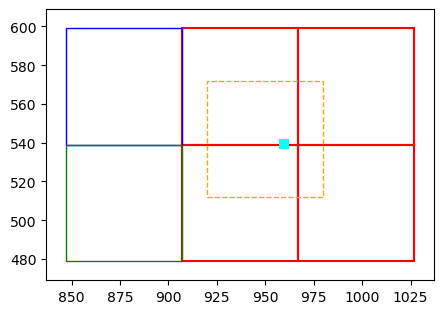

  Stim expansion for shift: [900, 492, 1000, 592]
  Writing lam stim 0: overlap 60, 47
  Writing lam stim 1: overlap 60, 53
  Writing lam stim 2: overlap 33, 53
  Writing lam stim 3: overlap 33, 47
  Writing ETstim 0: overlap 7, 53
  Writing ETstim 1: overlap 7, 47
  Adding fixation point
  Shifting stim...
  CROP: New stim size: 60 x 60
  Done


In [4]:
# Load shifts and previous models
dirname2 = dirname+'0715/et/'
SHfile = sio.loadmat( dirname2 + 'BDshifts1.mat' )
fix_n = SHfile['fix_n']
shifts = SHfile['shifts']
metricsLL = SHfile['metricsLL']
metricsTH = SHfile['metricsTH']
ETshifts = SHfile['ETshifts']
ETmetrics = SHfile['ETmetrics']
Ukeeps = SHfile['Ctrain']
XVkeeps = SHfile['Cval']

# Make 60x60 STAs (and GLMs)
Xshift = 14 #8+4 
Yshift = -3 #-10+4
NX = 60

new_tc = np.array([top_corner[0]-Xshift, top_corner[1]-Yshift], dtype=np.int64)
data.draw_stim_locations(top_corner = new_tc, L=NX)

data.assemble_stimulus(top_corner=[new_tc[0], new_tc[1]], L=NX, fixdot=0, shifts=-shifts, num_lags=num_lags)

In [5]:
goodfix = np.where(ETmetrics[:,1] < 0.80)[0]
valfix = torch.zeros([ETmetrics.shape[0], 1], dtype=torch.float32)
valfix[goodfix] = 1.0
# Test base-level performance (full DFs and then modify DFs)
#DFsave = deepcopy(data2.dfs)  # this is also in data.dfs
data.dfs_out *= valfix
("%0.1f%% fixations remaining"%(100*len(goodfix)/ETmetrics.shape[0]))
dirname2 = dirname+'0715/NewGLMs/'
matdat = sio.loadmat(dirname2+'J0715ProcGLMinfo.mat')

data.dfs.shape

torch.Size([167520, 239])

 # STAs

In [6]:
data.num_lags, data.stim.shape, data.robs.shape

(16, torch.Size([167520, 3600]), torch.Size([167520, 239]))

In [7]:
print(valET)

[ 20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  66  67  68  69  70  71  72  73  75
  77  78  79  80  81  82  83  84  86  87  88  89  90  92  93  95  96  97
  98  99 100 101 103 104 105 106 107 108 109 110 111 112 113 114 115 116
 117 118 119 120 121 122 123 124 125 126 127 152 153 154 155 156 157 159
 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177
 178 179 180 182 183 184 185 187 188 189 190 191 192 193 194 195 196 197
 198 200 203 204 205 206 207 208 209 210 211 213 214 216 217 218 219 220
 221 222 224 226 227 228 230 231 232 233 235 236]


In [8]:
Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
nspks = torch.sum(Reff, axis=0)
lag = 4
stas = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy()
stas.shape

(60, 60, 174)

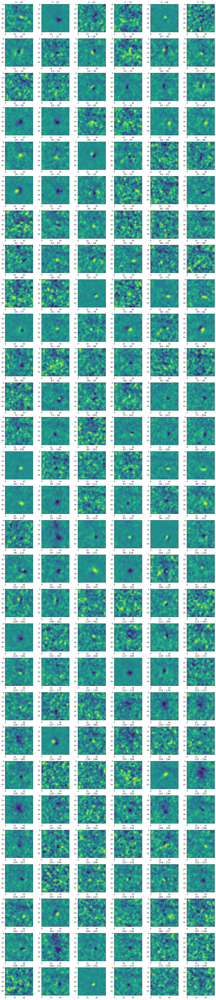

In [9]:
# plot some STAs
ss(29,6)
for cc in range(NCv):
    plt.subplot(29,6, cc+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

# interesting cells

In [11]:
stas = []
for lag in range(1,8):
    Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
    nspks = torch.sum(Reff, axis=0)
    stas.append(((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy())

In [12]:
len(stas), stas[0].shape

(7, (60, 60, 174))

STAs


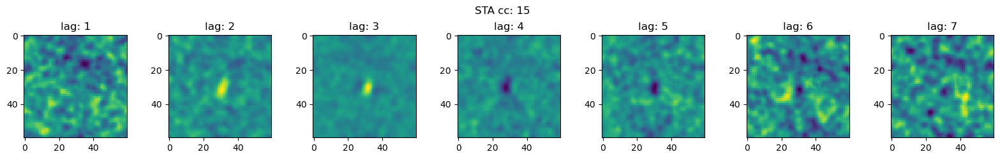

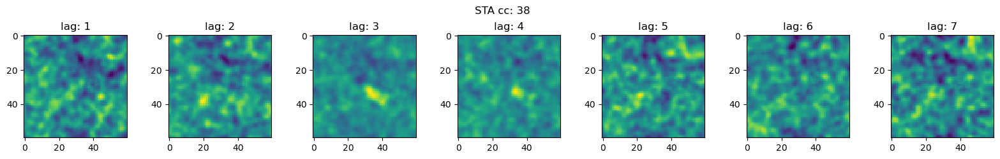

GLMs


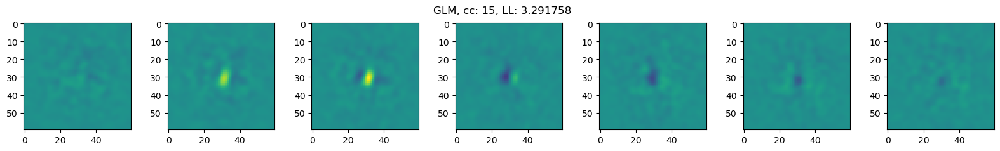

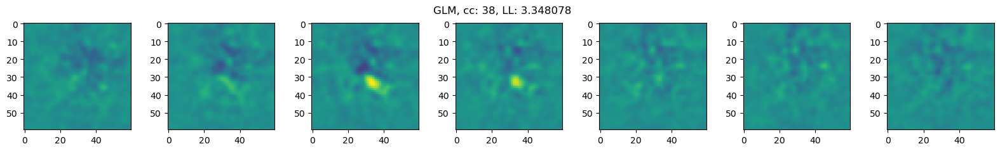

GQMs
-------------


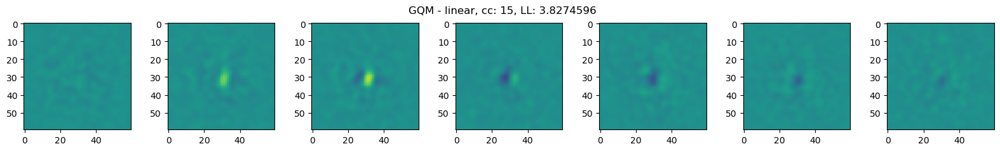

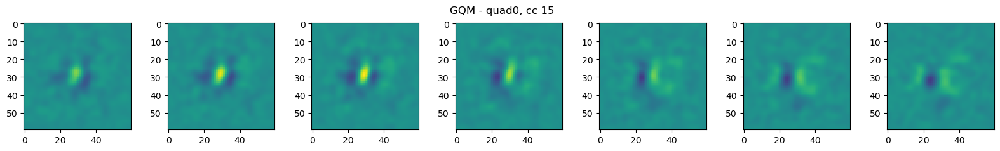

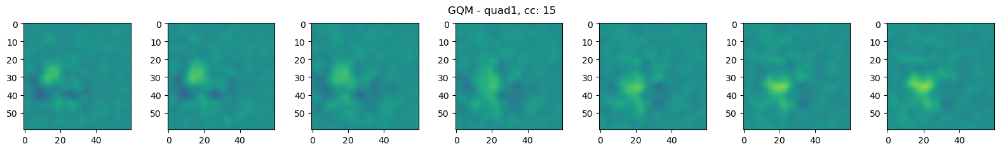

-------------


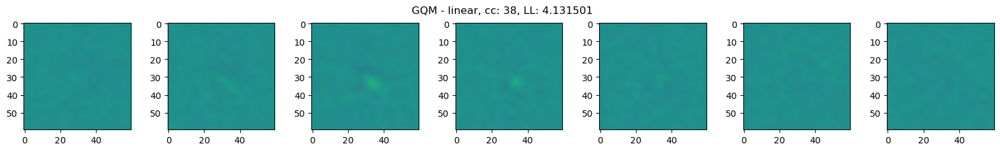

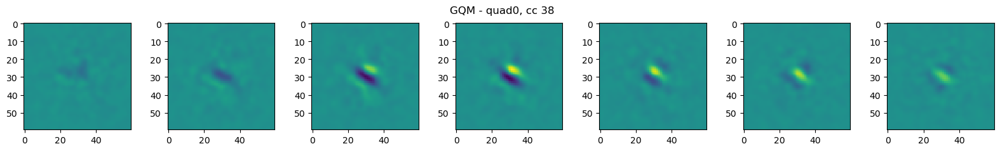

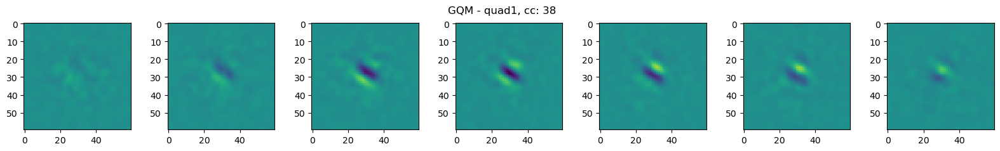

In [43]:
#interesting_cells = [18, 24, 38, 46, 54, 57]
interesting_cells = [15,38]

print("STAs")
for cc in interesting_cells:
    ss(1,7)
    col = 1
    for lag in range(len(stas)):
        plt.subplot(1,7, col)
        imagesc(stas[lag][:,:, cc])
        plt.title('lag: ' + str(lag+1))
        col += 1
    # adjust the plot down
    plt.subplots_adjust(top=0.8)
    plt.suptitle('STA cc: ' + str(cc))
plt.show()

print("GLMs")
for cc in range(len(interesting_cells)):
    max_weights = np.max(glms[cc].ndn_model.networks[0].layers[0].get_weights())
    ss(1,7)
    col = 1
    for lag in range(14, 7, -1):
        plt.subplot(1,7, col)
        imagesc(glms[cc].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc: ' + str(interesting_cells[cc]) + ', LL: ' + str(glms[cc].LLs))
        col += 1
    plt.show()

print("GQMs")
for cc in range(len(interesting_cells)):
    max_weights = 0
    weights_lin = np.max(gqms[cc].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[cc].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    print('-------------')
    ss(1,7)
    col = 1
    for lag in range(14, 7, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[cc].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc: ' + str(interesting_cells[cc]) + ', LL: ' + str(gqms[cc].LLs))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(14, 7, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[cc].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc ' + str(interesting_cells[cc]))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(14, 7, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[cc].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc: ' + str(interesting_cells[cc]))
        col += 1
    plt.show()

# simplest GLM

In [14]:
lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-8,
    tolerance_grad=1e-8,
    history_size=100,
    batch_size=20,
    max_epochs=3,
    max_iter=500,
    device=device)

# glm net
Treg = 1
Xreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 10.0 # [4.0]
glm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=1, bias=True, num_lags=num_lags,
    NLtype='softplus', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

glm = NDN.NDN(ffnet_list = [stim_net], loss_type='poisson')
glm.block_sample=True

glm.fit(data, force_dict_training=True, **lbfgs_pars)
LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]
print('LL: ' + str(LL))


GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 10.01384687423706 sec elapsed
LL: 2.7501824


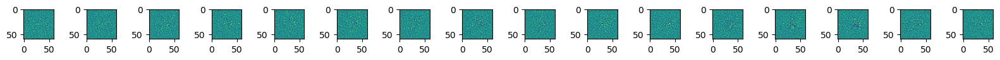

In [15]:
max_weights = np.max(glm.networks[0].layers[0].get_weights())
ss(1,num_lags)
col = 1
for lag in range(num_lags):
    plt.subplot(1,num_lags, col)
    imagesc(glm.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
    col += 1
plt.show()

# define models

In [20]:
#set up fits
Treg = 1
Xreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict(
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} }
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

# Drifts

## fit Drifts

In [22]:
def fit_drift(i, cc, folder):
    drift_model_filename = 'models/'+folder+'/drift_model_cc'+str(cc)+'.pkl'
    drift_study_filename = 'models/'+folder+'/drift_study_cc'+str(cc)+'.pkl'

    # continue if the file already exists
    if os.path.isfile(drift_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(drift_model_filename, 'rb') as f:
            drift = pickle.load(f)
        with open(drift_study_filename, 'rb') as f:
            study = pickle.load(f)
        return drift, study

    #data.set_cells(valET[cc])
    data.set_cells(cc)

    drifts_temp = []

    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=1e-8,
            tolerance_grad=1e-8,
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter = 500,
            device = device)

        # drift network
        drift_pars1 = NDNLayer.layer_dict(
            input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
        drift_pars1['reg_vals'] = {'d2t': trial.suggest_float('d2t', 0.0, 1.0), 'bcs':{'d2t':0} }
        # for stand-alone drift model
        drift_pars1N = deepcopy(drift_pars1)
        drift_pars1N['NLtype'] = 'softplus'
        drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

        drift_ndn = NDN.NDN(
            layer_list = [drift_pars1N], loss_type='poisson')
        drift_ndn.block_sample=True
        drift_ndn.networks[0].xstim_n = 'Xdrift'

        drift_ndn.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
        LL = drift_ndn.eval_models(data[data.val_blks], null_adjusted=False)[0]

        drift_model = Model(drift_ndn, LL, trial)
        drifts_temp.append(drift_model)

        return LL

    study = optuna.create_study(direction='minimize')

    # enqueue initial parameters
    study.enqueue_trial(
        {'d2t': Dreg})

    study.optimize(objective, n_trials=2)

    best_model = drifts_temp[study.best_trial.number]

    drifts.append(best_model)

    with open(drift_model_filename, 'wb') as f:
        pickle.dump(best_model, f)

    with open(drift_study_filename, 'wb') as f:
        pickle.dump(study, f)

    print(study.best_trial.number, study.best_params)
    return best_model, study

In [23]:
drifts = []
for i, cc in enumerate(enumerate(interesting_cells)):
    drift, study = fit_drift(i, cc, 'glms_03_debug')
    drifts.append(drift)

[I 2023-07-13 14:09:18,629] A new study created in memory with name: no-name-b8dd450b-7f05-417c-8c2f-d74b124e4c5c


Output set to 2 cells


[I 2023-07-13 14:09:19,141] Trial 0 finished with value: 6.168389320373535 and parameters: {'d2t': 0.1}. Best is trial 0 with value: 6.168389320373535.
[I 2023-07-13 14:09:19,665] Trial 1 finished with value: 6.168258190155029 and parameters: {'d2t': 0.3709467697122538}. Best is trial 1 with value: 6.168258190155029.
[I 2023-07-13 14:09:19,679] A new study created in memory with name: no-name-4b7808dd-929a-494c-bba4-5beda5aa7a70


1 {'d2t': 0.3709467697122538}
Output set to 2 cells


[I 2023-07-13 14:09:20,126] Trial 0 finished with value: 2.2765440940856934 and parameters: {'d2t': 0.1}. Best is trial 0 with value: 2.2765440940856934.
[I 2023-07-13 14:09:20,654] Trial 1 finished with value: 2.2765350341796875 and parameters: {'d2t': 0.47027600052990726}. Best is trial 1 with value: 2.2765350341796875.


1 {'d2t': 0.47027600052990726}


## plot Drifts

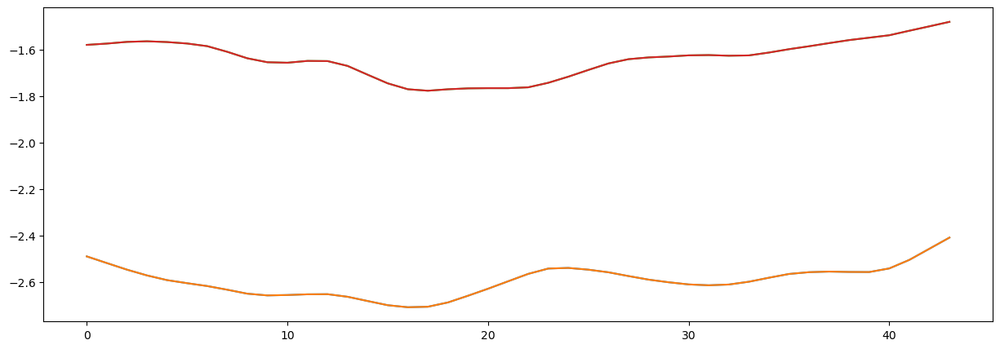

In [24]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    plt.plot(drift.ndn_model.networks[0].layers[0].get_weights())

# GLMs

## fit GLMs

In [27]:
def fit_glm(i, cc, folder):
    glm_model_filename = 'models/'+folder+'/glm_model_cc'+str(cc)+'.pkl'
    glm_study_filename = 'models/'+folder+'/glm_study_cc'+str(cc)+'.pkl'

    drift_weights = drifts[i].ndn_model.networks[0].layers[0].weight.data[:,0]

    # # continue if the file already exists
    # if os.path.isfile(glm_model_filename):
    #     # load the model and continue
    #     print('loading model', cc)
    #     with open(glm_model_filename, 'rb') as f:
    #         glm = pickle.load(f)
    #     with open(glm_study_filename, 'rb') as f:
    #         study = pickle.load(f)
    #     return glm, study

    data.set_cells(valET[cc])
    #data.set_cells(cc)

    LLsNULL = drifts[i].LLs

    glm = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
    glm.block_sample=True
    glm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    glm.networks[1].layers[0].set_parameters(val=False)
    glm.networks[2].layers[0].set_parameters(val=False,name='weight')

    glms_temp = []

    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=1e-8,
            tolerance_grad=1e-8,
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter=500,
            device=device)

        #glm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('d2x', 10, 30)
        #glm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('d2t', 0.5, 2)
        glm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('d2xt', 0.001, 10000)
        glm.networks[0].layers[0].reg.vals['l1'] = trial.suggest_float('l1', 0.001, 1)
        glm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('glocalx', 0.001, 1000)

        glm.fit(data, force_dict_training=True, trial=trial, **lbfgs_pars)
        LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]

        null_adjusted_LL = LLsNULL - LL

        glm_model = Model(glm, null_adjusted_LL, trial)
        glms_temp.append(glm_model)

        return null_adjusted_LL

    study = optuna.create_study(direction='maximize')

    # enqueue initial parameters
    study.enqueue_trial(
        {'d2xt': 0.001,
         'l1': 0.1,
         'glocalx': 10.0})
    study.enqueue_trial(
        {'d2xt': 0.01,
         'l1': 0.1,
         'glocalx': 10.0})
    study.enqueue_trial(
        {'d2xt': 0.1,
         'l1': 0.1,
         'glocalx': 10.0})
    study.enqueue_trial(
        {'d2xt': 1,
         'l1': 0.1,
         'glocalx': 10.0})
    study.enqueue_trial(
        {'d2xt': 10,
         'l1': 0.1,
         'glocalx': 10.0})

    study.optimize(objective, n_trials=20)

    best_model = glms_temp[study.best_trial.number]

    # save the model
    with open(glm_model_filename, 'wb') as f:
        pickle.dump(best_model, f)

    # save the study
    with open(glm_study_filename, 'wb') as f:
        pickle.dump(study, f)

    print(study.best_trial.number, study.best_params)
    return best_model, study

In [28]:
glms = []
for i, cc in enumerate(interesting_cells):
    glm, study = fit_glm(i, cc, folder='glms_03_debug')
    glms.append(glm)

[I 2023-07-13 14:09:53,379] A new study created in memory with name: no-name-1bbf2c76-26d6-4ff3-95fa-83c436eb4e7f


Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.377488613128662 sec elapsed


[I 2023-07-13 14:09:57,792] Trial 0 finished with value: 3.2917473316192627 and parameters: {'d2xt': 0.001, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.2917473316192627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.4959940910339355 sec elapsed


[I 2023-07-13 14:10:00,322] Trial 1 finished with value: 3.2917473316192627 and parameters: {'d2xt': 0.01, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.2917473316192627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.4722702503204346 sec elapsed


[I 2023-07-13 14:10:02,820] Trial 2 finished with value: 3.2917473316192627 and parameters: {'d2xt': 0.1, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.2917473316192627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.5304274559020996 sec elapsed


[I 2023-07-13 14:10:05,403] Trial 3 finished with value: 3.2917473316192627 and parameters: {'d2xt': 1.0, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.2917473316192627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.012099266052246 sec elapsed


[I 2023-07-13 14:10:08,454] Trial 4 finished with value: 3.2917580604553223 and parameters: {'d2xt': 10.0, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.236146688461304 sec elapsed


[I 2023-07-13 14:10:13,725] Trial 5 finished with value: 3.274663209915161 and parameters: {'d2xt': 5909.317387784255, 'l1': 0.12197564759858923, 'glocalx': 745.9269518411651}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.2549233436584473 sec elapsed


[I 2023-07-13 14:10:18,113] Trial 6 finished with value: 3.280021905899048 and parameters: {'d2xt': 529.3195236348841, 'l1': 0.8117813093007419, 'glocalx': 224.2910150155755}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.3718483448028564 sec elapsed


[I 2023-07-13 14:10:22,520] Trial 7 finished with value: 3.275271415710449 and parameters: {'d2xt': 6597.605714960262, 'l1': 0.7646765843005747, 'glocalx': 538.7318113430435}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.341113328933716 sec elapsed


[I 2023-07-13 14:10:26,893] Trial 8 finished with value: 3.2758212089538574 and parameters: {'d2xt': 996.3635386784878, 'l1': 0.9850324850490951, 'glocalx': 921.6049059672625}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.110279083251953 sec elapsed


[I 2023-07-13 14:10:31,020] Trial 9 finished with value: 3.2754459381103516 and parameters: {'d2xt': 3946.9313342259875, 'l1': 0.419315412429225, 'glocalx': 629.368226452401}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.7120349407196045 sec elapsed


[I 2023-07-13 14:10:34,768] Trial 10 finished with value: 3.2763924598693848 and parameters: {'d2xt': 9343.96882811594, 'l1': 0.30297285533006035, 'glocalx': 284.7786220567784}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.0886216163635254 sec elapsed


[I 2023-07-13 14:10:38,882] Trial 11 finished with value: 3.278385639190674 and parameters: {'d2xt': 2431.060113492453, 'l1': 0.2873256492604888, 'glocalx': 248.6258523308709}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.754798173904419 sec elapsed


[I 2023-07-13 14:10:42,692] Trial 12 finished with value: 3.2773215770721436 and parameters: {'d2xt': 2422.8617295762215, 'l1': 0.02961032794443222, 'glocalx': 361.67185589171305}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.9835312366485596 sec elapsed


[I 2023-07-13 14:10:46,720] Trial 13 finished with value: 3.2802767753601074 and parameters: {'d2xt': 1955.7417013654779, 'l1': 0.25023412825237085, 'glocalx': 145.31260315643087}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.469362258911133 sec elapsed


[I 2023-07-13 14:10:51,252] Trial 14 finished with value: 3.2766871452331543 and parameters: {'d2xt': 3610.376507065722, 'l1': 0.5115931519427718, 'glocalx': 395.6454819151876}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.756826162338257 sec elapsed


[I 2023-07-13 14:10:55,048] Trial 15 finished with value: 3.2807424068450928 and parameters: {'d2xt': 1427.9577771592037, 'l1': 0.030585603136609504, 'glocalx': 138.0108808085794}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.352050542831421 sec elapsed


[I 2023-07-13 14:10:58,538] Trial 16 finished with value: 3.2813613414764404 and parameters: {'d2xt': 1549.1164798781751, 'l1': 0.20883221418992634, 'glocalx': 112.02835774749515}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.4883763790130615 sec elapsed


[I 2023-07-13 14:11:03,073] Trial 17 finished with value: 3.276646852493286 and parameters: {'d2xt': 3395.0977385263327, 'l1': 0.3826170876240722, 'glocalx': 411.4725322062138}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.8780763149261475 sec elapsed


[I 2023-07-13 14:11:07,018] Trial 18 finished with value: 3.2810723781585693 and parameters: {'d2xt': 1164.6009787271769, 'l1': 0.011228374203485561, 'glocalx': 132.04683677165104}. Best is trial 4 with value: 3.2917580604553223.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.9910621643066406 sec elapsed


[I 2023-07-13 14:11:11,063] Trial 19 finished with value: 3.2787039279937744 and parameters: {'d2xt': 2395.731927252664, 'l1': 0.19304858961925236, 'glocalx': 224.71384829144355}. Best is trial 4 with value: 3.2917580604553223.
[I 2023-07-13 14:11:11,081] A new study created in memory with name: no-name-4abc6fe4-6938-4b84-986d-817226d8d8f4


4 {'d2xt': 10.0, 'l1': 0.1, 'glocalx': 10.0}
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.3663501739501953 sec elapsed


[I 2023-07-13 14:11:15,497] Trial 0 finished with value: 3.3461551666259766 and parameters: {'d2xt': 0.001, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.3461551666259766.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.5160784721374512 sec elapsed


[I 2023-07-13 14:11:18,079] Trial 1 finished with value: 3.3461551666259766 and parameters: {'d2xt': 0.01, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.3461551666259766.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.5138676166534424 sec elapsed


[I 2023-07-13 14:11:20,650] Trial 2 finished with value: 3.3461551666259766 and parameters: {'d2xt': 0.1, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.3461551666259766.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.4856343269348145 sec elapsed


[I 2023-07-13 14:11:23,181] Trial 3 finished with value: 3.3461551666259766 and parameters: {'d2xt': 1.0, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 0 with value: 3.3461551666259766.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 1.9810807704925537 sec elapsed


[I 2023-07-13 14:11:26,225] Trial 4 finished with value: 3.3461906909942627 and parameters: {'d2xt': 10.0, 'l1': 0.1, 'glocalx': 10.0}. Best is trial 4 with value: 3.3461906909942627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.7579238414764404 sec elapsed


[I 2023-07-13 14:11:31,061] Trial 5 finished with value: 3.3402814865112305 and parameters: {'d2xt': 5388.993366769914, 'l1': 0.3491994545712617, 'glocalx': 191.8370659980191}. Best is trial 4 with value: 3.3461906909942627.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.0869152545928955 sec elapsed


[I 2023-07-13 14:11:35,287] Trial 6 finished with value: 3.3480780124664307 and parameters: {'d2xt': 2268.93313855334, 'l1': 0.010929908658575432, 'glocalx': 11.15084627721277}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.0992705821990967 sec elapsed


[I 2023-07-13 14:11:39,402] Trial 7 finished with value: 3.3404483795166016 and parameters: {'d2xt': 3763.46792261421, 'l1': 0.1661309264391729, 'glocalx': 174.12700678223925}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.1787192821502686 sec elapsed


[I 2023-07-13 14:11:43,658] Trial 8 finished with value: 3.3374264240264893 and parameters: {'d2xt': 3982.4369192616664, 'l1': 0.06634420230063115, 'glocalx': 727.453601987467}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.162572145462036 sec elapsed


[I 2023-07-13 14:11:47,883] Trial 9 finished with value: 3.3403186798095703 and parameters: {'d2xt': 7316.5713775916565, 'l1': 0.6997532033189411, 'glocalx': 193.2487261582362}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.746051073074341 sec elapsed


[I 2023-07-13 14:11:51,681] Trial 10 finished with value: 3.3383140563964844 and parameters: {'d2xt': 9929.806947216468, 'l1': 0.46273069043875437, 'glocalx': 490.1771373051838}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.008302688598633 sec elapsed


[I 2023-07-13 14:11:55,739] Trial 11 finished with value: 3.3384430408477783 and parameters: {'d2xt': 2200.721914348121, 'l1': 0.30233390439342955, 'glocalx': 401.3800242944497}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.7165474891662598 sec elapsed


[I 2023-07-13 14:11:59,501] Trial 12 finished with value: 3.3367555141448975 and parameters: {'d2xt': 2067.881704382311, 'l1': 0.9114943953366952, 'glocalx': 996.4329388672477}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.6091058254241943 sec elapsed


[I 2023-07-13 14:12:03,158] Trial 13 finished with value: 3.3390581607818604 and parameters: {'d2xt': 2616.1152791677027, 'l1': 0.29943196575631703, 'glocalx': 305.11249990451483}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.2298197746276855 sec elapsed


[I 2023-07-13 14:12:06,443] Trial 14 finished with value: 3.338773727416992 and parameters: {'d2xt': 1629.5422176822435, 'l1': 0.024921046606122543, 'glocalx': 333.2747415821873}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.7257072925567627 sec elapsed


[I 2023-07-13 14:12:10,232] Trial 15 finished with value: 3.340545415878296 and parameters: {'d2xt': 1402.8263533587865, 'l1': 0.2492263895007057, 'glocalx': 149.3579670897006}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.7454493045806885 sec elapsed


[I 2023-07-13 14:12:14,127] Trial 16 finished with value: 3.3377468585968018 and parameters: {'d2xt': 1102.7330909902998, 'l1': 0.023062356634327638, 'glocalx': 545.9927102191839}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.244877815246582 sec elapsed


[I 2023-07-13 14:12:18,423] Trial 17 finished with value: 3.341799020767212 and parameters: {'d2xt': 3394.3888454707576, 'l1': 0.21873934133525852, 'glocalx': 101.54289135603415}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.2470858097076416 sec elapsed


[I 2023-07-13 14:12:22,719] Trial 18 finished with value: 3.339113235473633 and parameters: {'d2xt': 1116.5467413114893, 'l1': 0.4335131686856959, 'glocalx': 272.0719211234406}. Best is trial 6 with value: 3.3480780124664307.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 2.744309186935425 sec elapsed


[I 2023-07-13 14:12:26,510] Trial 19 finished with value: 3.3413143157958984 and parameters: {'d2xt': 3017.9398440414734, 'l1': 0.18240514197327057, 'glocalx': 120.58805192940325}. Best is trial 6 with value: 3.3480780124664307.


6 {'d2xt': 2268.93313855334, 'l1': 0.010929908658575432, 'glocalx': 11.15084627721277}


## plot GLMs

/tmp/ipykernel_1303543/3598426068.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,num_lags, col)


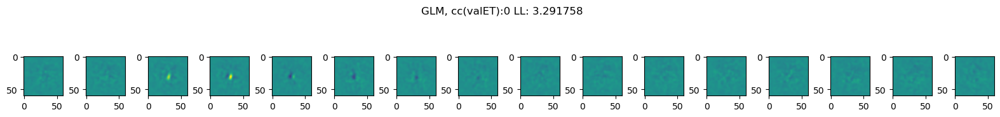

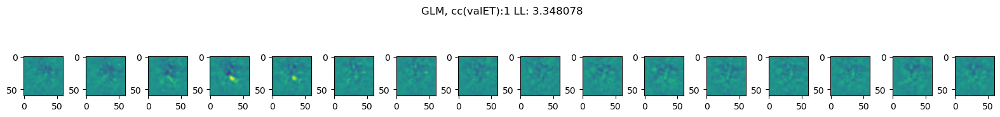

In [30]:
for i in range(len(glms)):
    max_weights = np.max(glms[i].ndn_model.networks[0].layers[0].get_weights())
    ss(1,10)
    col = 1
    for lag in range(num_lags-1, -1, -1):
        plt.subplot(1,num_lags, col)
        imagesc(glms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc(valET):' + str(i) + ' LL: ' + str(glms[i].LLs))
        col += 1
    plt.show()

0.0019235611
0.053796053
0.02038598
0.0631547
0.013866425


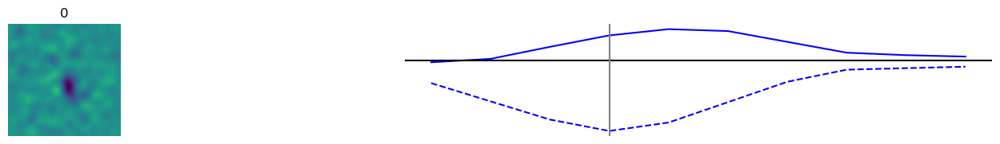

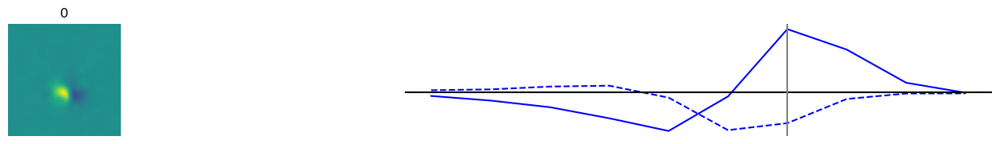

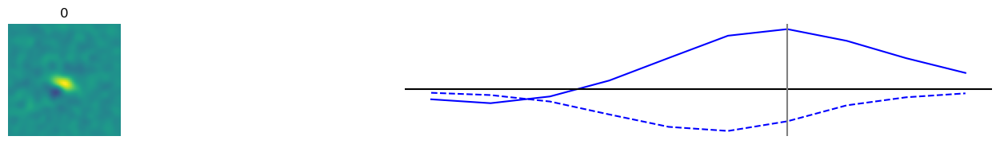

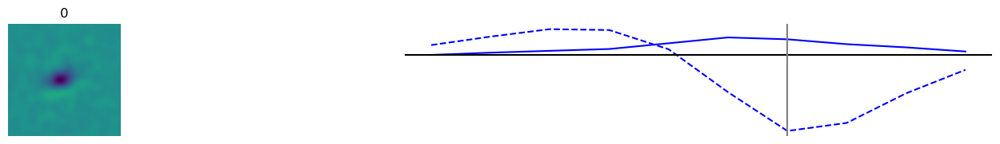

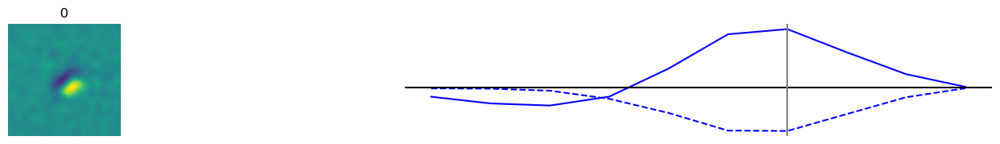

In [118]:
for glm in glms:
    print(glm.LLs)
    glm.ndn_model.plot_filters()

# GQMs

## fit GQMs

In [34]:
def fit_gqm(i, cc, folder):
    gqm_model_filename = 'models/'+folder+'/gqm_model_cc'+str(cc)+'.pkl'
    gqm_study_filename = 'models/'+folder+'/gqm_study_cc'+str(cc)+'.pkl'
    
    drift_weights = drifts[i].ndn_model.networks[0].layers[0].weight.data[:,0]
    
    # continue if the file already exists
    if os.path.isfile(gqm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(gqm_model_filename, 'rb') as f:
            gqm = pickle.load(f)
        with open(gqm_study_filename, 'rb') as f:
            study = pickle.load(f)
        return gqm, study

    data.set_cells(valET[cc])
    #data.set_cells(cc)
    
    LLsNULL = drifts[i].LLs
    
    # get the best reg_vals for the GLM
    best_reg_vals = glms[i].ndn_model.networks[0].layers[0].reg.vals
    stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)
    gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
    gqm.networks[0].layers[0] = deepcopy(glms[i].ndn_model.networks[0].layers[0])
    gqm.block_sample=True
    gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
    gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    gqm.networks[1].layers[0].set_parameters(val=False)
    
    gqms_temp = []
    
    def objective(trial):
        lbfgs_pars = utils.create_optimizer_params(
            optimizer_type='lbfgs',
            tolerance_change=1e-8,
            tolerance_grad=1e-8,
            history_size=100,
            batch_size=20,
            max_epochs=3,
            max_iter = 500,
            device = device)
    
        # gqm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('lin_d2x', 10, 30)
        # gqm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('lin_d2t', 0.5, 2)
        # gqm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('lin_d2xt', 0.001, 10000)
        # gqm.networks[0].layers[0].reg.vals['l1'] = trial.suggest_float('lin_l1', 0.01, 1)
        # gqm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('lin_glocalx', 0.001, 20)
    
        #gqm.networks[2].layers[0].reg.vals['d2x'] = trial.suggest_float('quad_d2x', 10, 30)
        #gqm.networks[2].layers[0].reg.vals['d2t'] = trial.suggest_float('quad_d2t', 0.5, 2)
        gqm.networks[2].layers[0].reg.vals['d2xt'] = trial.suggest_float('quad_d2xt', 0.001, 10000)
        gqm.networks[2].layers[0].reg.vals['l1'] = trial.suggest_float('quad_la', 0.01, 1)
        gqm.networks[2].layers[0].reg.vals['glocalx'] = trial.suggest_float('quad_glocalx', 0.001, 20)
    
        gqm.fit( data, force_dict_training=True, **lbfgs_pars)
        LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]
    
        null_adjusted_LL = LLsNULL - LL
    
        gqm_model = Model(gqm, null_adjusted_LL, trial)
        gqms_temp.append(gqm_model)
    
        return null_adjusted_LL
    
    study = optuna.create_study(direction='maximize')
    
    # enqueue initial parameters
    study.enqueue_trial(
        {'quad_d2xt': 0.001,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0})
    study.enqueue_trial(
        {'quad_d2xt': 0.01,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0})
    study.enqueue_trial(
        {'quad_d2xt': 0.1,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0})
    study.enqueue_trial(
        {'quad_d2xt': 1,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0})
    study.enqueue_trial(
        {'quad_d2xt': 10,
         'quad_l1': 0.1,
         'quad_glocalx': 10.0})
    
    study.optimize(objective, n_trials=20)
    
    best_model = gqms_temp[study.best_trial.number]
    
    with open(gqm_model_filename, 'wb') as f:
        pickle.dump(best_model, f)
    
    with open(gqm_study_filename, 'wb') as f:
        pickle.dump(study, f)
    
    print(study.best_trial.number, study.best_params)
    return best_model, study

In [35]:
gqms = []
gqm_studies = []
for i, cc in enumerate(interesting_cells):
    gqm, study = fit_gqm(i, cc, 'glms_03_debug')
    gqms.append(gqm)
    gqm_studies.append(study)

[I 2023-07-13 14:15:38,294] A new study created in memory with name: no-name-7a7cdf88-3da1-44da-9bc5-a1569ebe65f3


Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 46.92727828025818 sec elapsed


[I 2023-07-13 14:16:27,247] Trial 0 finished with value: 3.815585136413574 and parameters: {'quad_d2xt': 0.001, 'quad_la': 0.7637673242562164, 'quad_glocalx': 10.0}. Best is trial 0 with value: 3.815585136413574.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.211649179458618 sec elapsed


[I 2023-07-13 14:16:34,662] Trial 1 finished with value: 3.815526247024536 and parameters: {'quad_d2xt': 0.01, 'quad_la': 0.6305849037333905, 'quad_glocalx': 10.0}. Best is trial 0 with value: 3.815585136413574.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.040985107421875 sec elapsed


[I 2023-07-13 14:16:41,738] Trial 2 finished with value: 3.8155815601348877 and parameters: {'quad_d2xt': 0.1, 'quad_la': 0.7301037977429776, 'quad_glocalx': 10.0}. Best is trial 0 with value: 3.815585136413574.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.6270487308502197 sec elapsed


[I 2023-07-13 14:16:47,437] Trial 3 finished with value: 3.8154592514038086 and parameters: {'quad_d2xt': 1.0, 'quad_la': 0.26364498435283934, 'quad_glocalx': 10.0}. Best is trial 0 with value: 3.815585136413574.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.786384105682373 sec elapsed


[I 2023-07-13 14:16:53,244] Trial 4 finished with value: 3.815481424331665 and parameters: {'quad_d2xt': 10.0, 'quad_la': 0.240048114189092, 'quad_glocalx': 10.0}. Best is trial 0 with value: 3.815585136413574.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 22.578588724136353 sec elapsed


[I 2023-07-13 14:17:17,844] Trial 5 finished with value: 3.8259541988372803 and parameters: {'quad_d2xt': 2835.934767825913, 'quad_la': 0.2469857304518623, 'quad_glocalx': 18.522785267532758}. Best is trial 5 with value: 3.8259541988372803.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 46.488401651382446 sec elapsed


[I 2023-07-13 14:18:06,393] Trial 6 finished with value: 3.801156520843506 and parameters: {'quad_d2xt': 5717.514299283022, 'quad_la': 0.7474576286395145, 'quad_glocalx': 0.7892428383422588}. Best is trial 5 with value: 3.8259541988372803.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 21.859499216079712 sec elapsed


[I 2023-07-13 14:18:30,303] Trial 7 finished with value: 3.8261330127716064 and parameters: {'quad_d2xt': 2792.395521556744, 'quad_la': 0.8933147932387663, 'quad_glocalx': 17.24625118503554}. Best is trial 7 with value: 3.8261330127716064.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 17.556666374206543 sec elapsed


[I 2023-07-13 14:18:49,853] Trial 8 finished with value: 3.8273513317108154 and parameters: {'quad_d2xt': 9633.273574182514, 'quad_la': 0.9974000562843254, 'quad_glocalx': 18.871600570600666}. Best is trial 8 with value: 3.8273513317108154.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 24.913634061813354 sec elapsed


[I 2023-07-13 14:19:16,725] Trial 9 finished with value: 3.8219988346099854 and parameters: {'quad_d2xt': 2719.92871664585, 'quad_la': 0.4367377571019202, 'quad_glocalx': 8.355256565130237}. Best is trial 8 with value: 3.8273513317108154.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 23.648194074630737 sec elapsed


[I 2023-07-13 14:19:42,343] Trial 10 finished with value: 3.827388286590576 and parameters: {'quad_d2xt': 9220.585644768826, 'quad_la': 0.9740816848292172, 'quad_glocalx': 19.801441016938035}. Best is trial 10 with value: 3.827388286590576.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.71143913269043 sec elapsed


[I 2023-07-13 14:19:50,039] Trial 11 finished with value: 3.8274595737457275 and parameters: {'quad_d2xt': 9814.908470012824, 'quad_la': 0.9767363763306527, 'quad_glocalx': 19.936806319791085}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 8.565715789794922 sec elapsed


[I 2023-07-13 14:20:00,608] Trial 12 finished with value: 3.826852321624756 and parameters: {'quad_d2xt': 9984.03358973069, 'quad_la': 0.9877620511092133, 'quad_glocalx': 14.786735853339103}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 8.076747417449951 sec elapsed


[I 2023-07-13 14:20:10,671] Trial 13 finished with value: 3.827293872833252 and parameters: {'quad_d2xt': 8462.113769267111, 'quad_la': 0.8706488141980038, 'quad_glocalx': 19.542532075906685}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 8.540796995162964 sec elapsed


[I 2023-07-13 14:20:21,292] Trial 14 finished with value: 3.826659679412842 and parameters: {'quad_d2xt': 8037.425116395687, 'quad_la': 0.5171958313656206, 'quad_glocalx': 15.490739018058939}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 8.030850887298584 sec elapsed


[I 2023-07-13 14:20:31,313] Trial 15 finished with value: 3.8273355960845947 and parameters: {'quad_d2xt': 7904.727120484791, 'quad_la': 0.8837193985285272, 'quad_glocalx': 19.817985834870168}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 8.741959571838379 sec elapsed


[I 2023-07-13 14:20:42,022] Trial 16 finished with value: 3.8263344764709473 and parameters: {'quad_d2xt': 7149.381983946628, 'quad_la': 0.09136635342404337, 'quad_glocalx': 14.94436150235955}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 9.080297470092773 sec elapsed


[I 2023-07-13 14:20:53,123] Trial 17 finished with value: 3.827233076095581 and parameters: {'quad_d2xt': 9421.775108504195, 'quad_la': 0.9914725958178686, 'quad_glocalx': 17.011749518985027}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 9.815515518188477 sec elapsed


[I 2023-07-13 14:21:04,957] Trial 18 finished with value: 3.826007127761841 and parameters: {'quad_d2xt': 6653.948165511774, 'quad_la': 0.6367784291404929, 'quad_glocalx': 13.544771587257433}. Best is trial 11 with value: 3.8274595737457275.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 10.03754734992981 sec elapsed


[I 2023-07-13 14:21:17,021] Trial 19 finished with value: 3.8274455070495605 and parameters: {'quad_d2xt': 8919.512561318526, 'quad_la': 0.8168194616180882, 'quad_glocalx': 19.84601021593801}. Best is trial 11 with value: 3.8274595737457275.
[I 2023-07-13 14:21:17,067] A new study created in memory with name: no-name-eefa59bd-156e-4ba3-9247-7ce1aea63cc9


11 {'quad_d2xt': 9814.908470012824, 'quad_la': 0.9767363763306527, 'quad_glocalx': 19.936806319791085}
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 26.38139510154724 sec elapsed


[I 2023-07-13 14:21:45,472] Trial 0 finished with value: 4.12717342376709 and parameters: {'quad_d2xt': 0.001, 'quad_la': 0.43522464237206343, 'quad_glocalx': 10.0}. Best is trial 0 with value: 4.12717342376709.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.157778739929199 sec elapsed


[I 2023-07-13 14:21:51,675] Trial 1 finished with value: 4.127301216125488 and parameters: {'quad_d2xt': 0.01, 'quad_la': 0.8463206617191553, 'quad_glocalx': 10.0}. Best is trial 1 with value: 4.127301216125488.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 3.582113027572632 sec elapsed


[I 2023-07-13 14:21:57,323] Trial 2 finished with value: 4.127309799194336 and parameters: {'quad_d2xt': 0.1, 'quad_la': 0.8316222392958796, 'quad_glocalx': 10.0}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.444891691207886 sec elapsed


[I 2023-07-13 14:22:04,810] Trial 3 finished with value: 4.127035140991211 and parameters: {'quad_d2xt': 1.0, 'quad_la': 0.13995781719648315, 'quad_glocalx': 10.0}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.0853800773620605 sec elapsed


[I 2023-07-13 14:22:10,946] Trial 4 finished with value: 4.12709903717041 and parameters: {'quad_d2xt': 10.0, 'quad_la': 0.16277837786927718, 'quad_glocalx': 10.0}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 23.87725591659546 sec elapsed


[I 2023-07-13 14:22:36,864] Trial 5 finished with value: 4.112072944641113 and parameters: {'quad_d2xt': 5661.735851784885, 'quad_la': 0.683619867134511, 'quad_glocalx': 2.422007052990639}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 14.260319709777832 sec elapsed


[I 2023-07-13 14:22:53,148] Trial 6 finished with value: 4.117621421813965 and parameters: {'quad_d2xt': 5804.03262988214, 'quad_la': 0.09321089520594406, 'quad_glocalx': 4.389225791779569}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 33.43108677864075 sec elapsed


[I 2023-07-13 14:23:28,722] Trial 7 finished with value: 4.108537197113037 and parameters: {'quad_d2xt': 5984.198178531688, 'quad_la': 0.8585893624579986, 'quad_glocalx': 1.9271312668929859}. Best is trial 2 with value: 4.127309799194336.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 16.132245779037476 sec elapsed


[I 2023-07-13 14:23:46,865] Trial 8 finished with value: 4.127741813659668 and parameters: {'quad_d2xt': 3620.5418871828847, 'quad_la': 0.7498722325951723, 'quad_glocalx': 17.238128165120575}. Best is trial 8 with value: 4.127741813659668.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 12.20771074295044 sec elapsed


[I 2023-07-13 14:24:01,084] Trial 9 finished with value: 4.124966621398926 and parameters: {'quad_d2xt': 6561.37986677887, 'quad_la': 0.7638212150195828, 'quad_glocalx': 18.945117579344156}. Best is trial 8 with value: 4.127741813659668.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 10.269441604614258 sec elapsed


[I 2023-07-13 14:24:13,377] Trial 10 finished with value: 4.123607635498047 and parameters: {'quad_d2xt': 9423.797999900713, 'quad_la': 0.9935814467270965, 'quad_glocalx': 19.01343566612977}. Best is trial 8 with value: 4.127741813659668.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 13.664312601089478 sec elapsed


[I 2023-07-13 14:24:29,101] Trial 11 finished with value: 4.128772735595703 and parameters: {'quad_d2xt': 2524.76786698749, 'quad_la': 0.6021726382622881, 'quad_glocalx': 14.365881428411416}. Best is trial 11 with value: 4.128772735595703.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.035765647888184 sec elapsed


[I 2023-07-13 14:24:36,179] Trial 12 finished with value: 4.129093170166016 and parameters: {'quad_d2xt': 2518.2130936367175, 'quad_la': 0.573605853724959, 'quad_glocalx': 15.985650874377486}. Best is trial 12 with value: 4.129093170166016.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.273364782333374 sec elapsed


[I 2023-07-13 14:24:42,515] Trial 13 finished with value: 4.128992080688477 and parameters: {'quad_d2xt': 2473.3378517498954, 'quad_la': 0.5423390979813817, 'quad_glocalx': 15.086833722738321}. Best is trial 12 with value: 4.129093170166016.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.227984189987183 sec elapsed


[I 2023-07-13 14:24:48,713] Trial 14 finished with value: 4.12890625 and parameters: {'quad_d2xt': 2470.0504905771186, 'quad_la': 0.4363060329682641, 'quad_glocalx': 14.711214995512101}. Best is trial 12 with value: 4.129093170166016.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 10.466399908065796 sec elapsed


[I 2023-07-13 14:25:01,190] Trial 15 finished with value: 4.126529216766357 and parameters: {'quad_d2xt': 3985.79439771528, 'quad_la': 0.5122124838261972, 'quad_glocalx': 14.213910332800058}. Best is trial 12 with value: 4.129093170166016.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 11.91192102432251 sec elapsed


[I 2023-07-13 14:25:15,081] Trial 16 finished with value: 4.130168914794922 and parameters: {'quad_d2xt': 1803.757178146861, 'quad_la': 0.329794110045448, 'quad_glocalx': 16.030359929000653}. Best is trial 16 with value: 4.130168914794922.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 6.7013397216796875 sec elapsed


[I 2023-07-13 14:25:23,824] Trial 17 finished with value: 4.130958557128906 and parameters: {'quad_d2xt': 1597.397304160397, 'quad_la': 0.2919904433042233, 'quad_glocalx': 19.874419918803017}. Best is trial 17 with value: 4.130958557128906.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.713456392288208 sec elapsed


[I 2023-07-13 14:25:31,567] Trial 18 finished with value: 4.131501197814941 and parameters: {'quad_d2xt': 1243.6221806375506, 'quad_la': 0.29027301514756265, 'quad_glocalx': 19.957522335653383}. Best is trial 18 with value: 4.131501197814941.



GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.216439485549927 sec elapsed


[I 2023-07-13 14:25:38,822] Trial 19 finished with value: 4.131092548370361 and parameters: {'quad_d2xt': 1539.8095254444574, 'quad_la': 0.2631797849193774, 'quad_glocalx': 19.653716120561874}. Best is trial 18 with value: 4.131501197814941.


18 {'quad_d2xt': 1243.6221806375506, 'quad_la': 0.29027301514756265, 'quad_glocalx': 19.957522335653383}


## plot GQMs

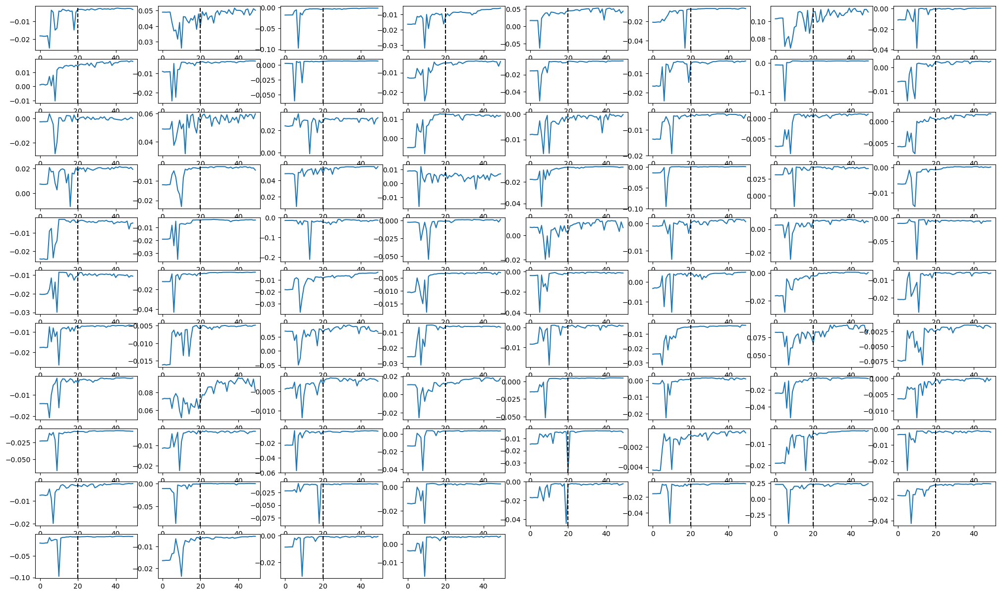

In [12]:
# plot GQM study
fig = plt.figure(figsize=(25, 15))
grid = plt.GridSpec(11, 8, hspace=0.2, wspace=0.2)
for i in range(84):
    row,col = np.unravel_index(i, (11,8))
    ax = fig.add_subplot(grid[row,col])
    ax.plot(gqm_studies[i].trials_dataframe()['value'])
    # draw vertical line
    ax.axvline(x=20, color='k', linestyle='--')

-------------


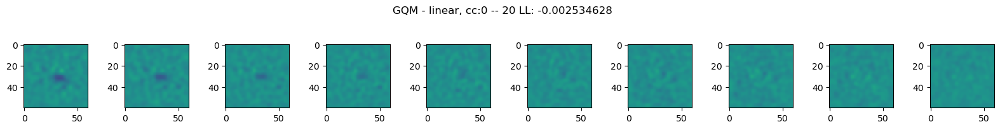

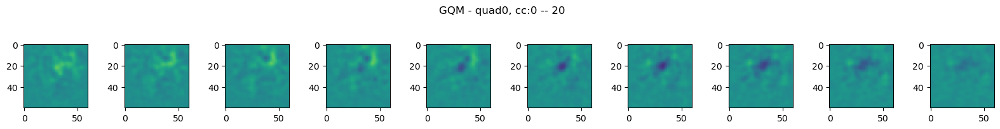

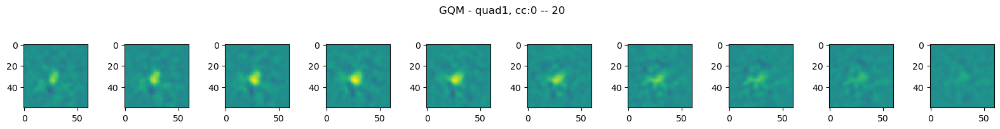

-------------


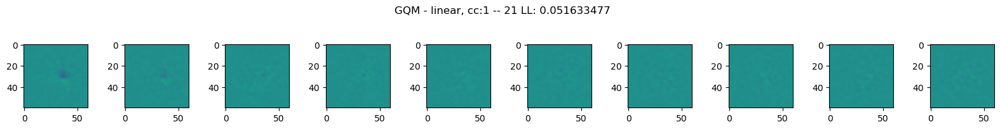

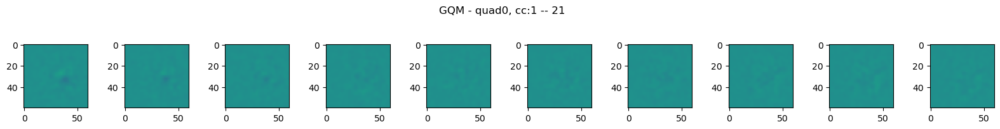

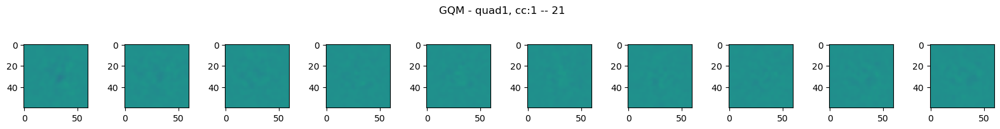

-------------


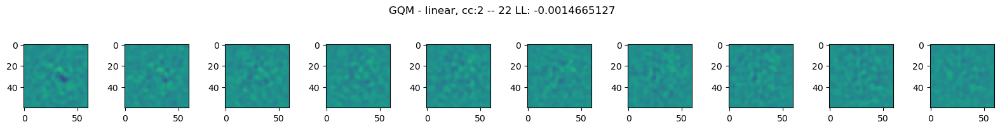

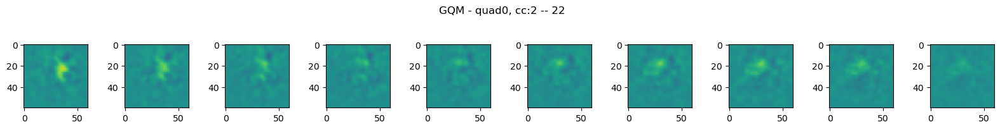

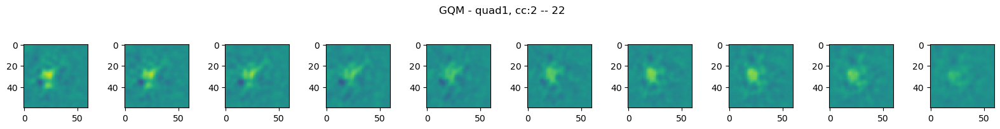

-------------


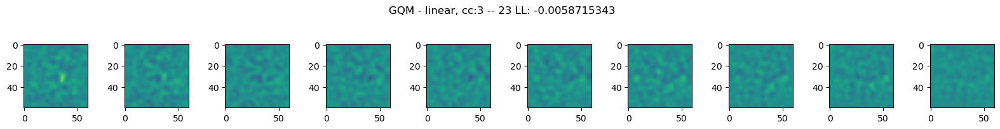

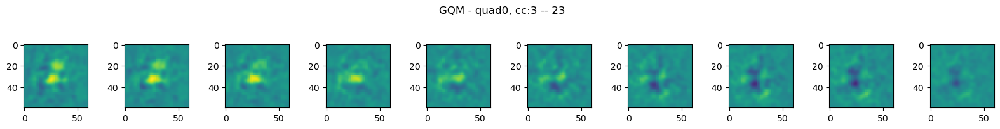

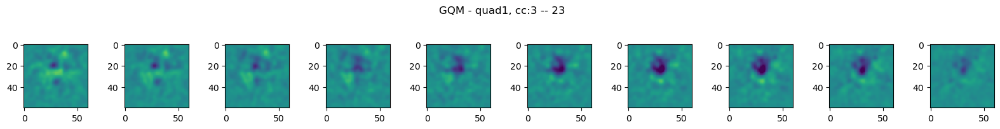

-------------


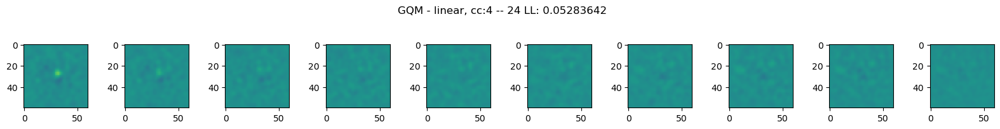

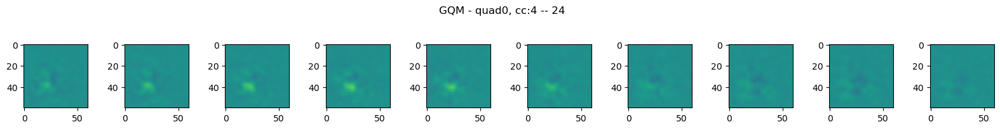

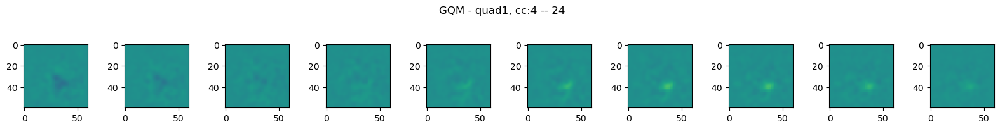

-------------


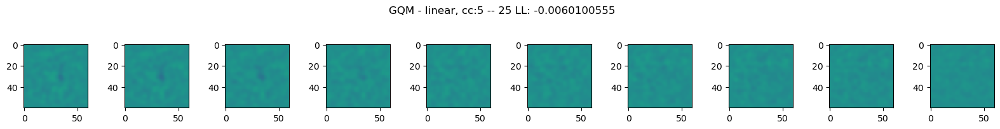

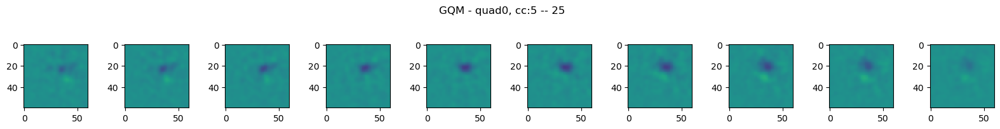

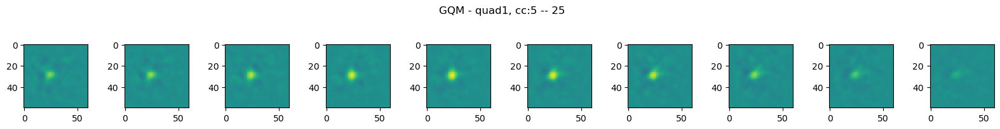

-------------


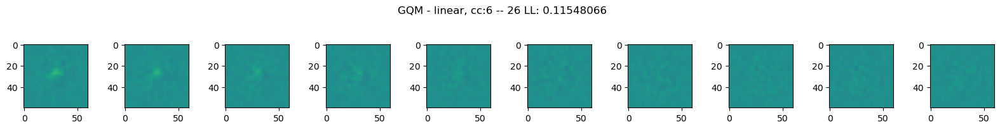

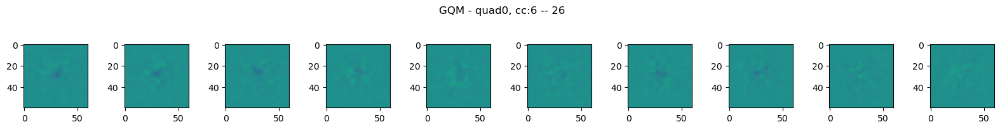

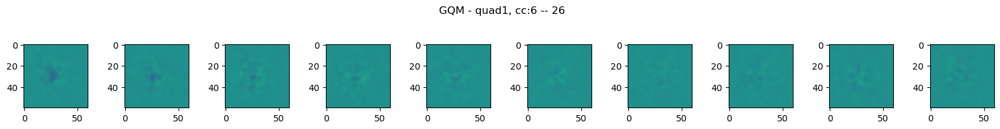

-------------


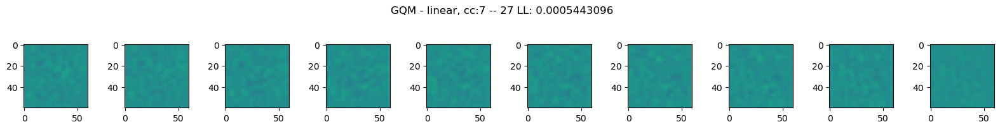

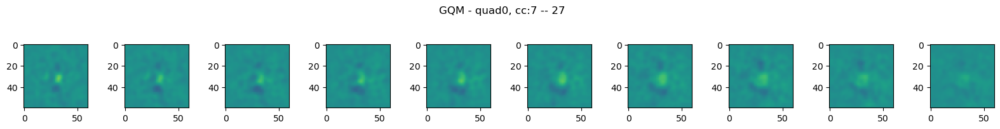

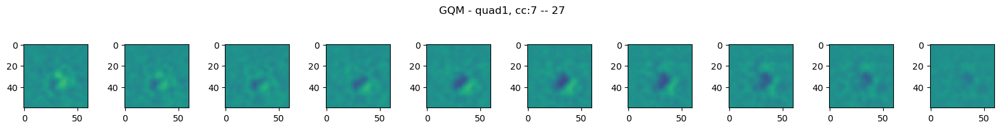

-------------


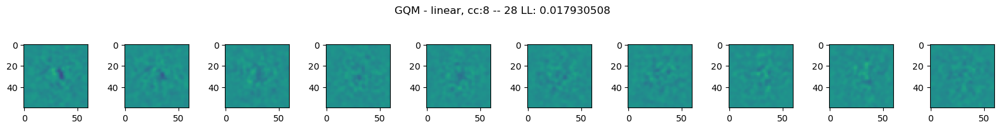

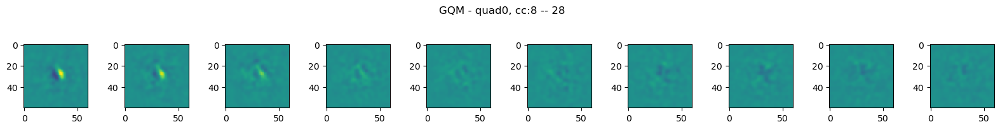

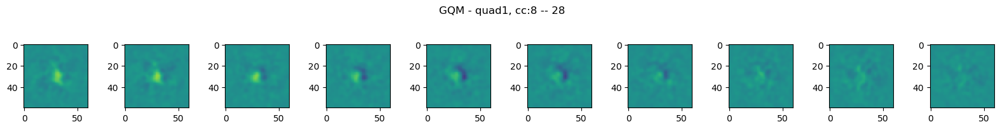

-------------


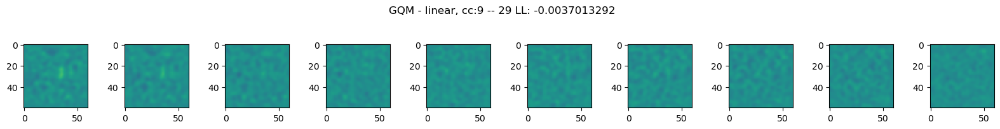

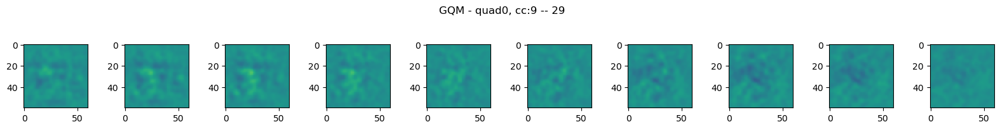

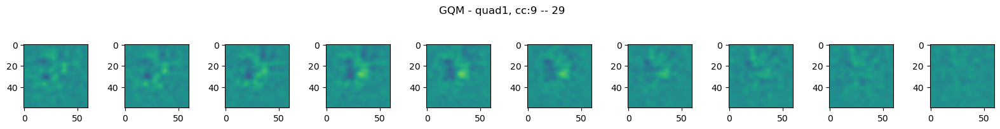

-------------


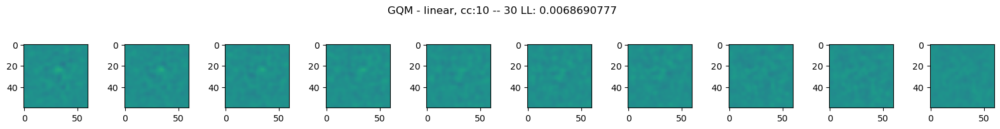

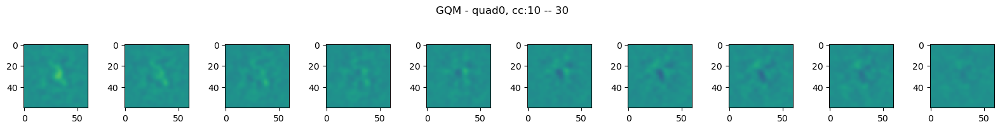

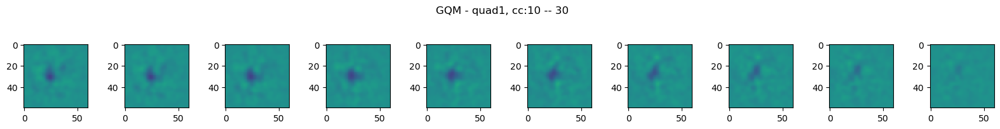

-------------


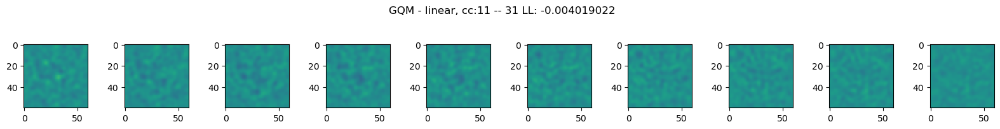

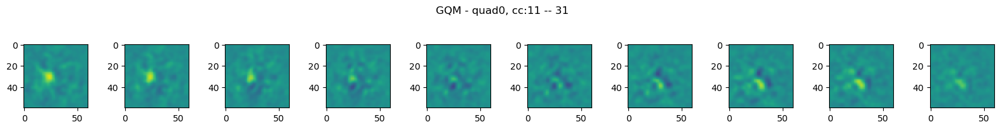

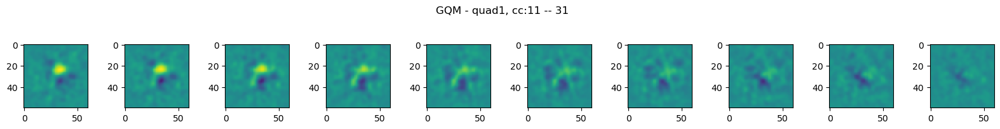

-------------


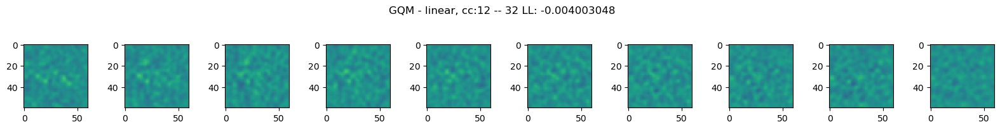

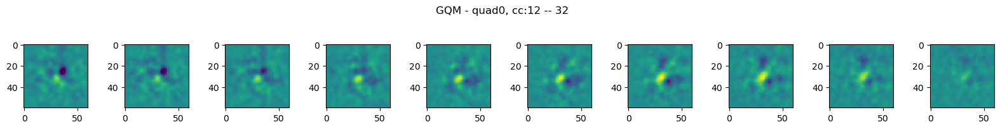

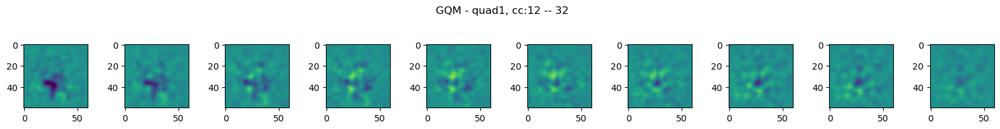

-------------


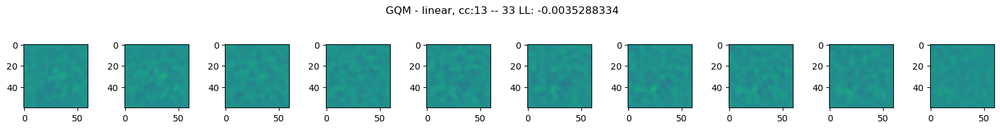

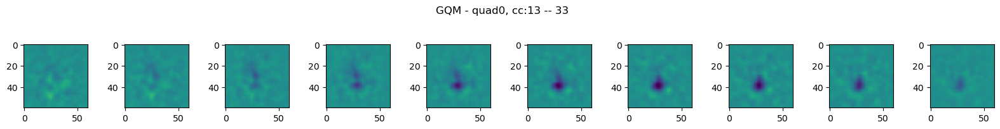

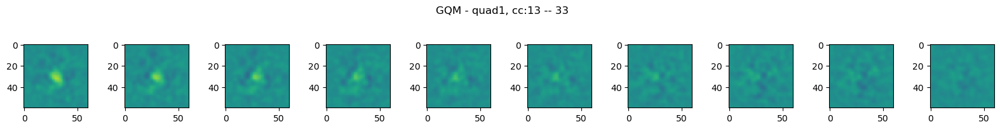

-------------


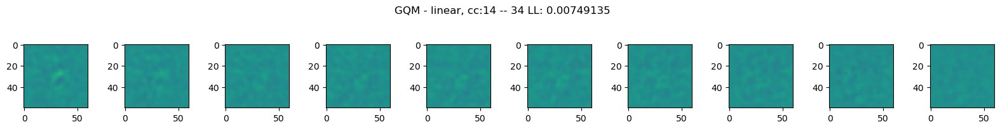

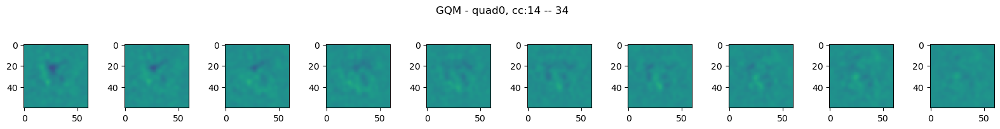

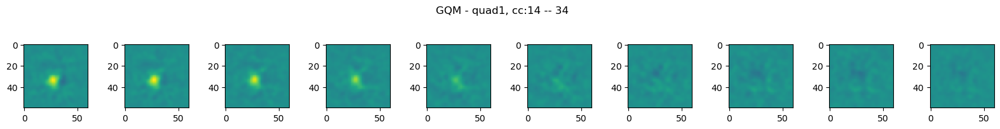

-------------


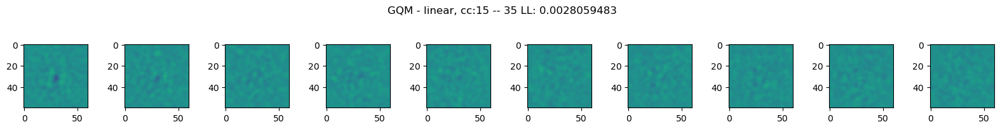

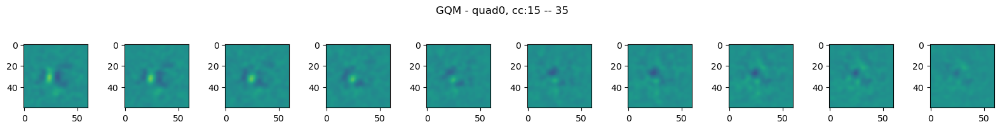

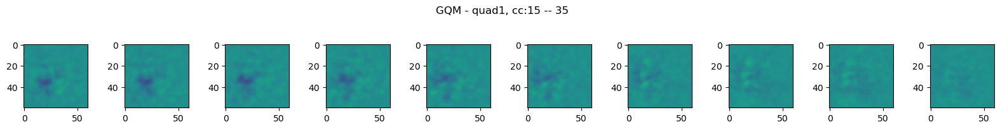

-------------


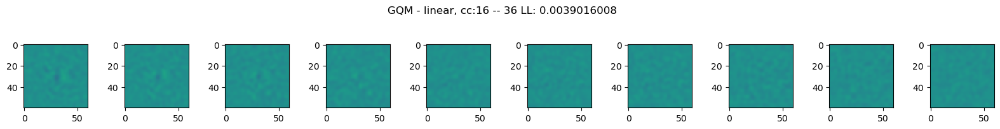

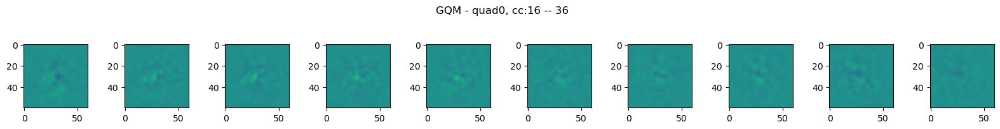

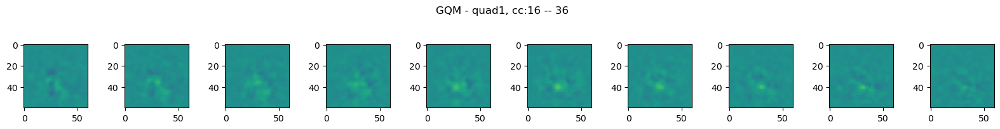

-------------


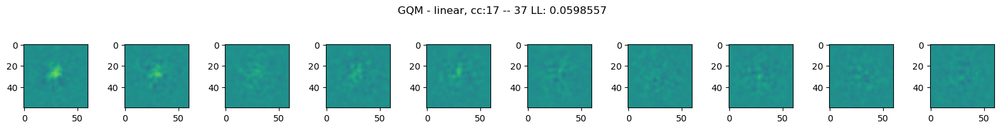

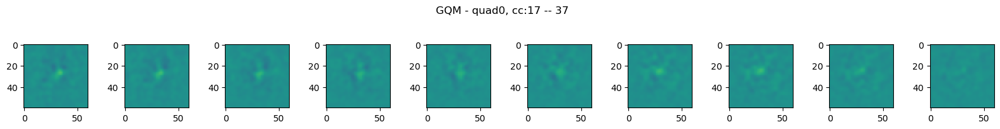

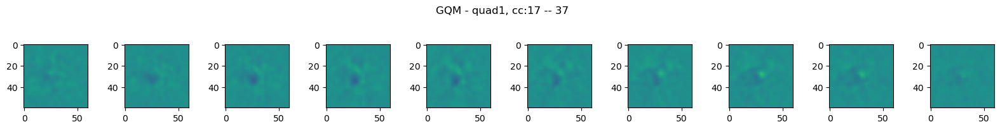

-------------


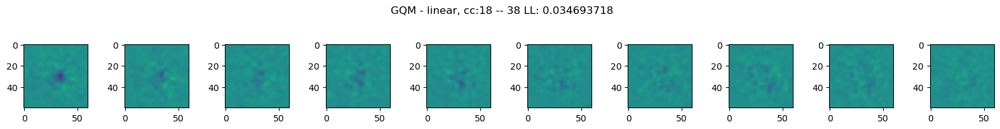

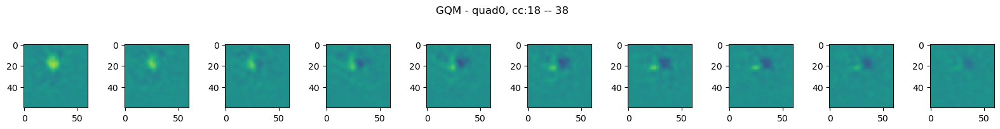

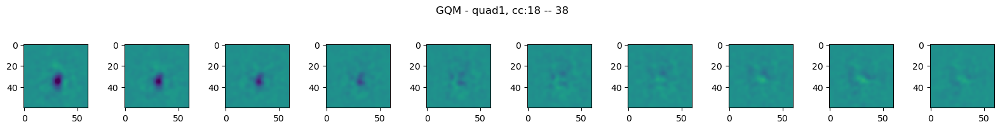

-------------


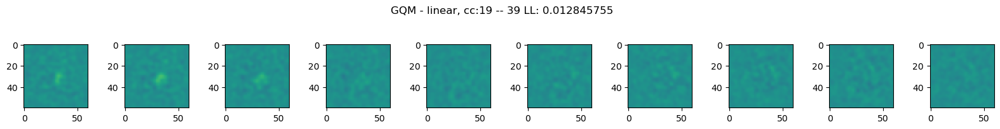

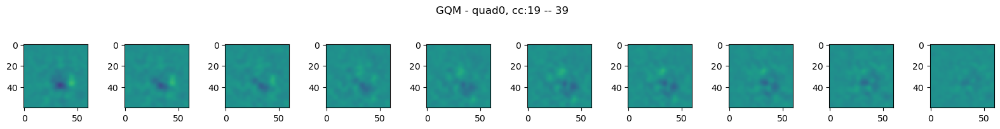

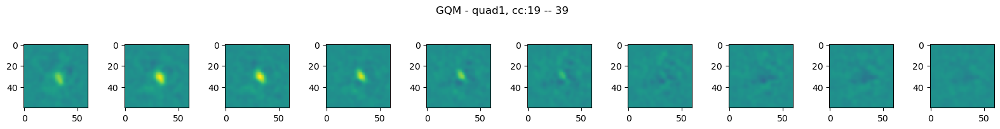

-------------


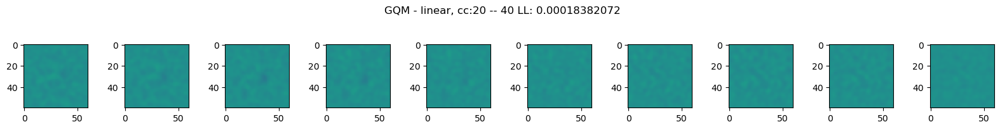

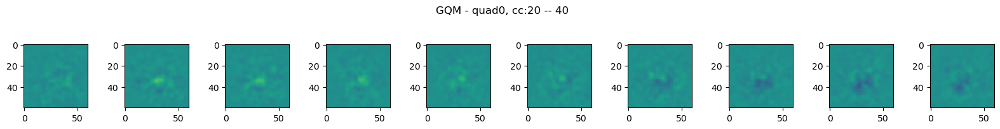

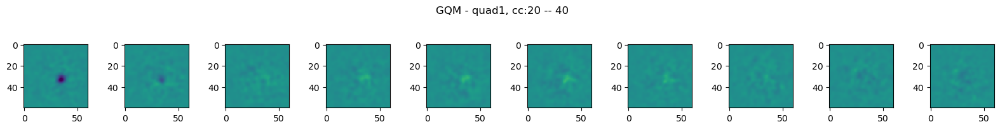

-------------


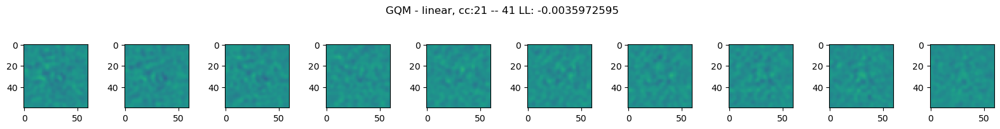

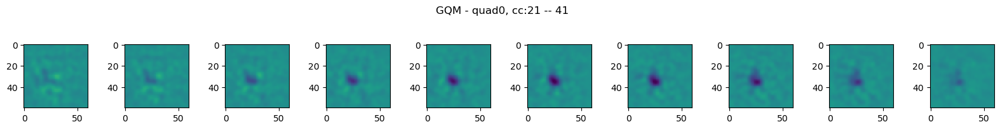

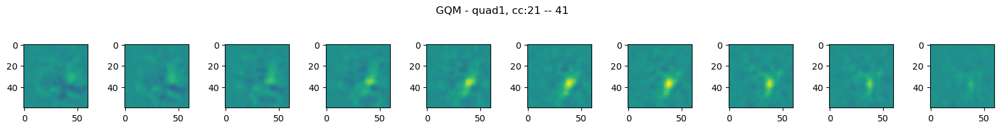

-------------


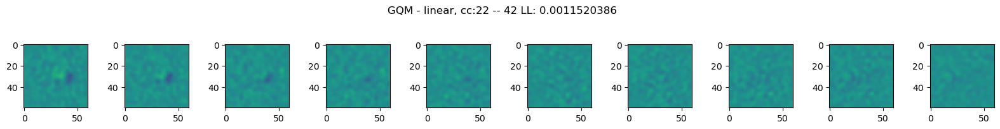

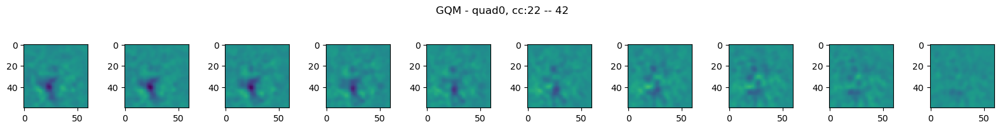

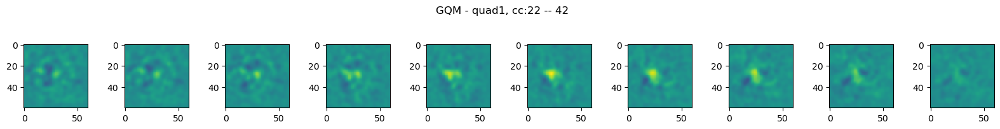

-------------


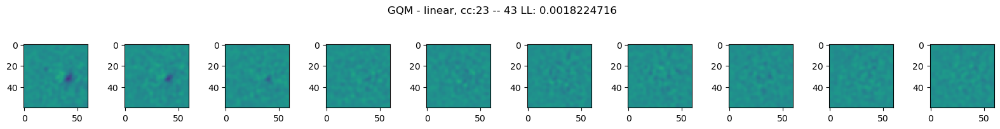

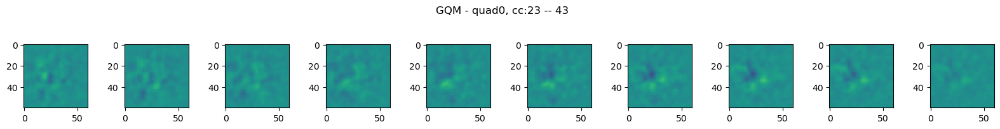

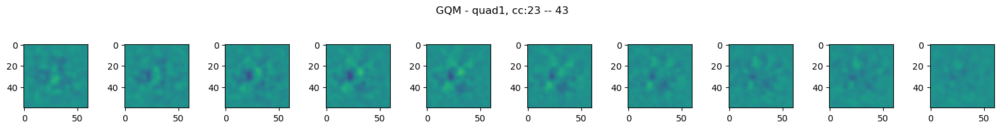

-------------


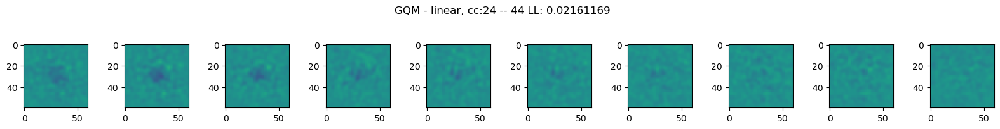

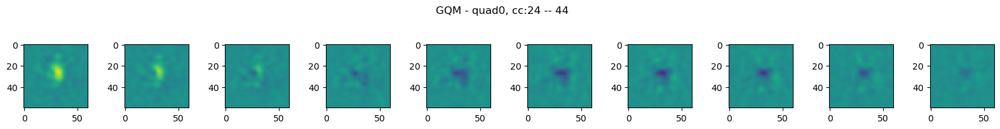

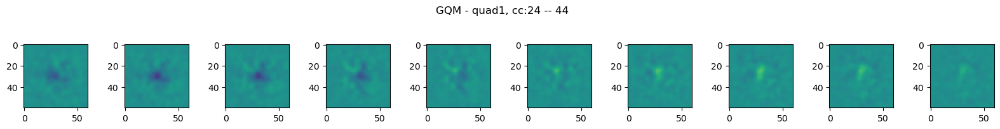

-------------


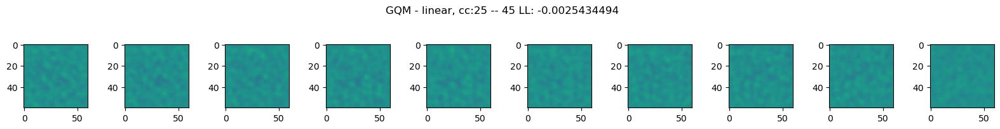

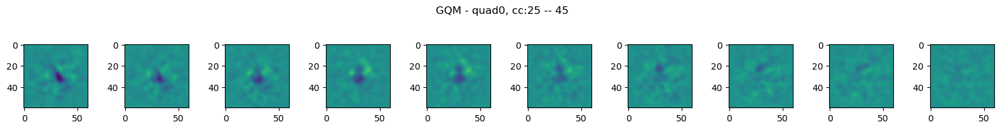

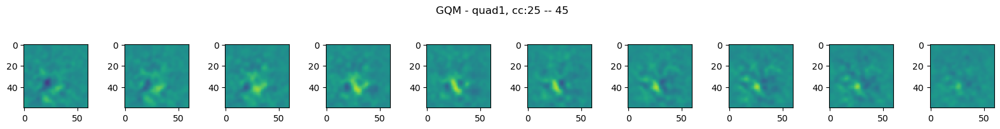

-------------


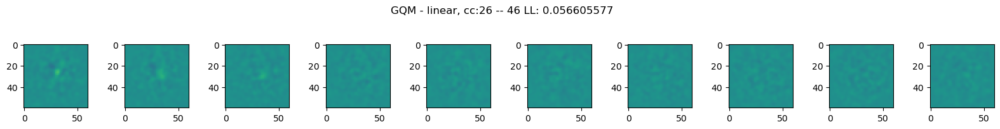

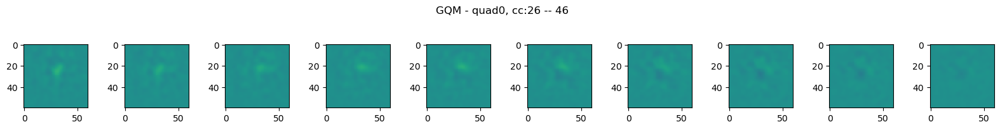

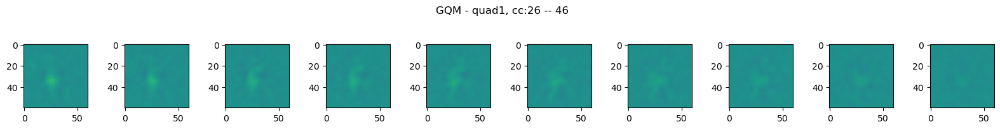

-------------


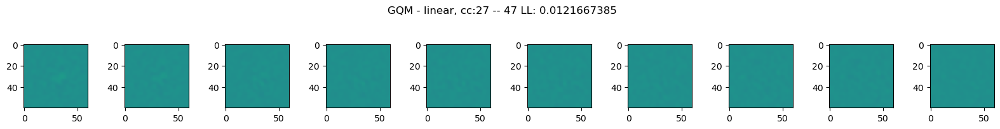

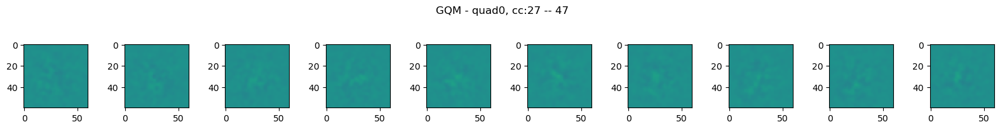

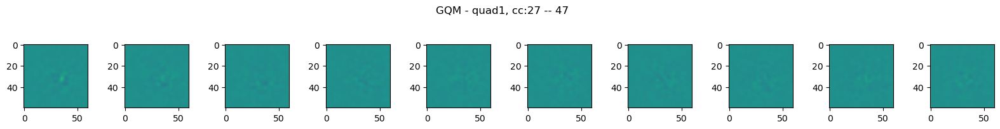

-------------


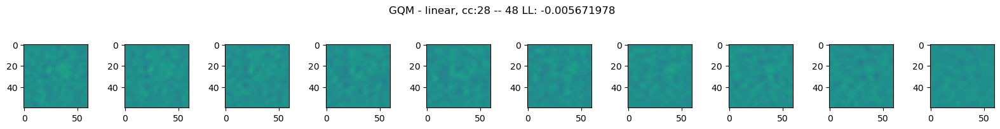

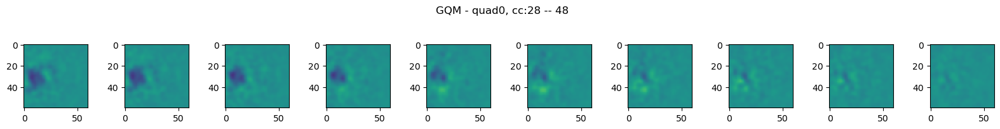

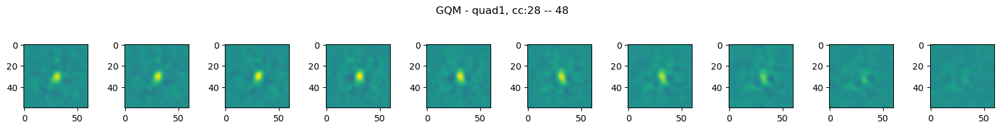

-------------


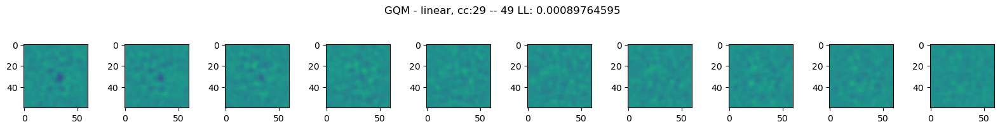

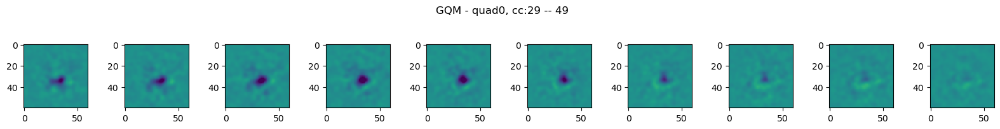

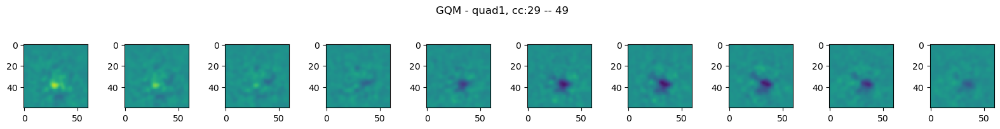

-------------


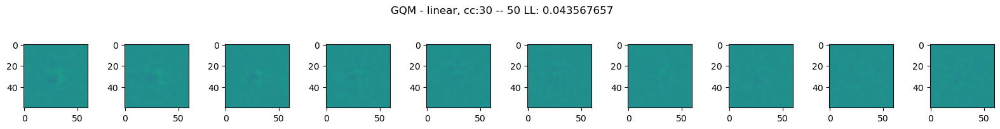

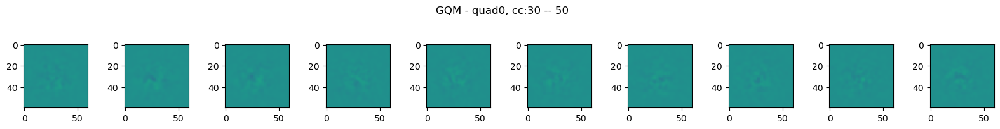

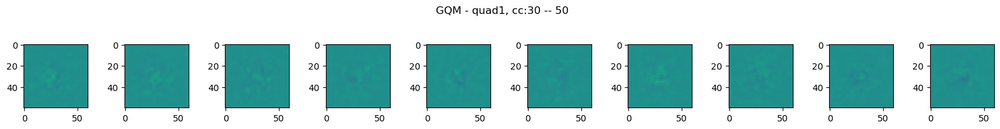

-------------


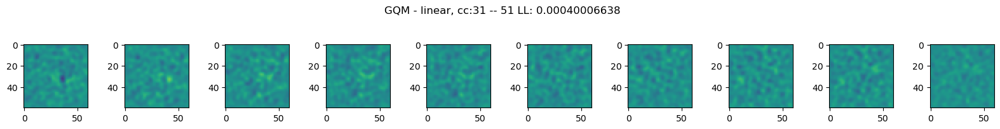

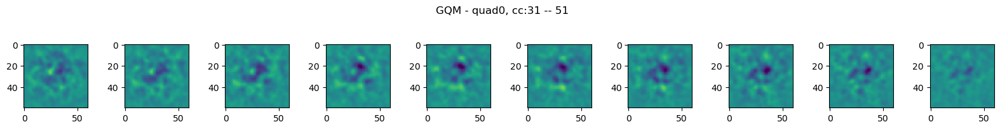

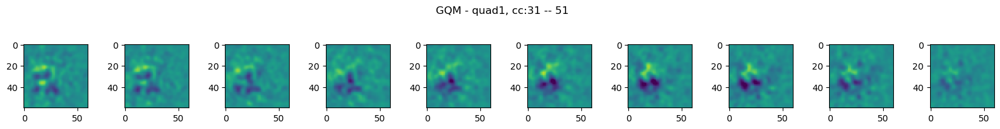

-------------


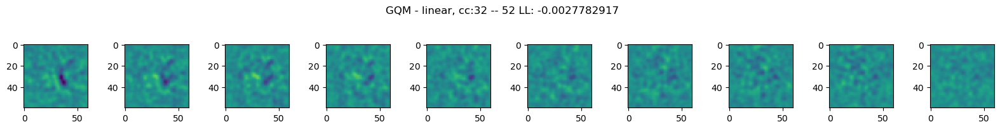

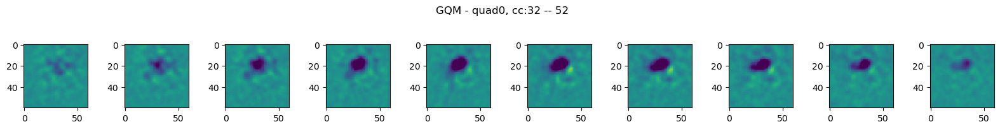

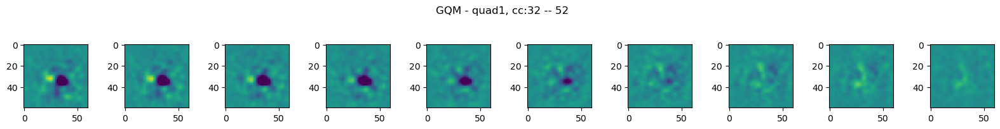

-------------


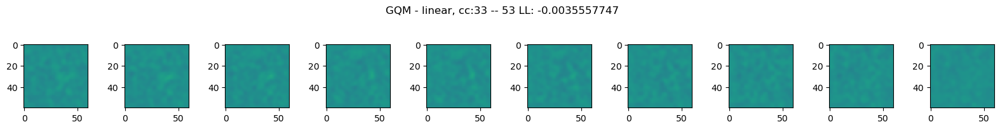

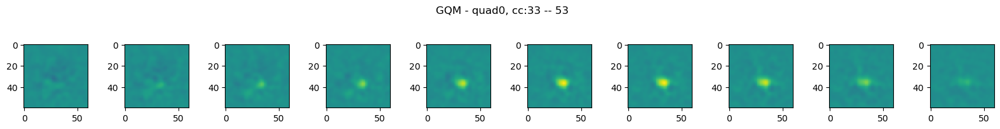

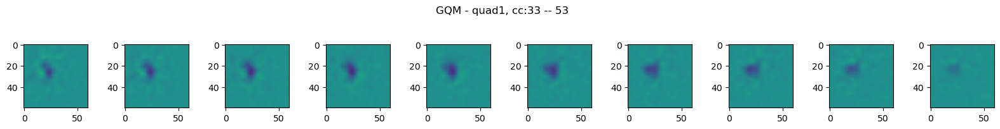

-------------


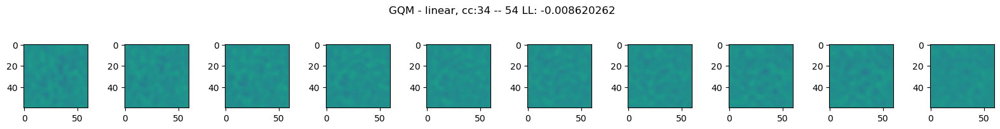

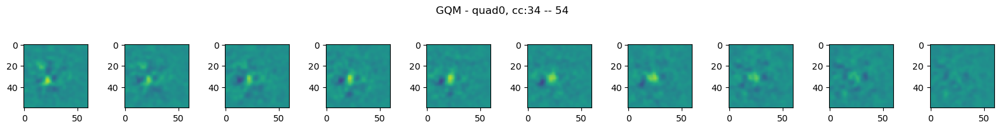

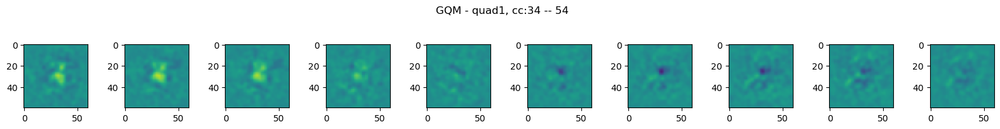

-------------


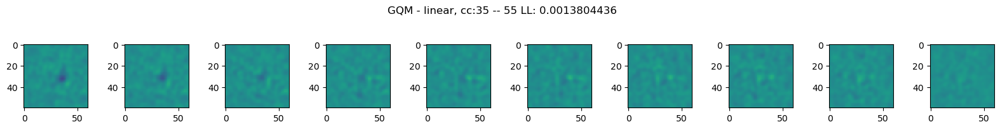

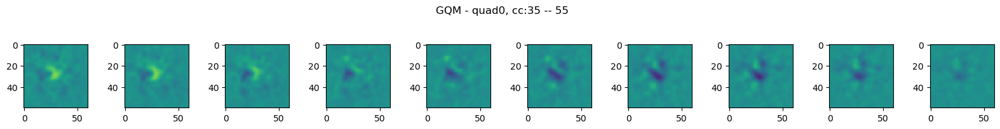

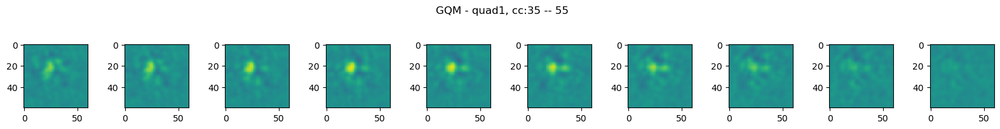

-------------


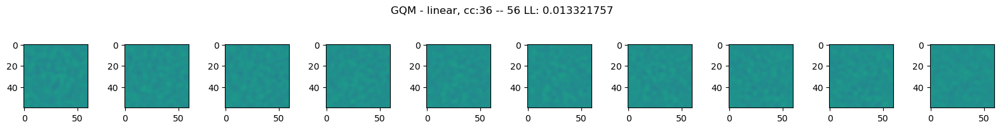

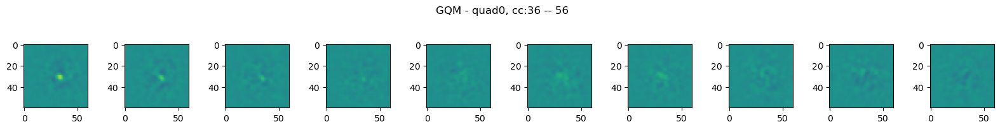

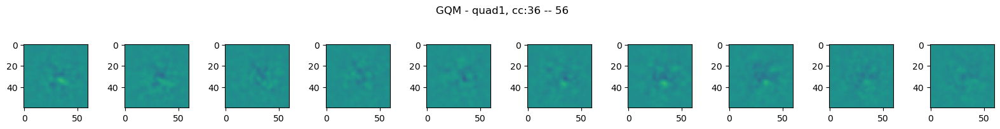

-------------


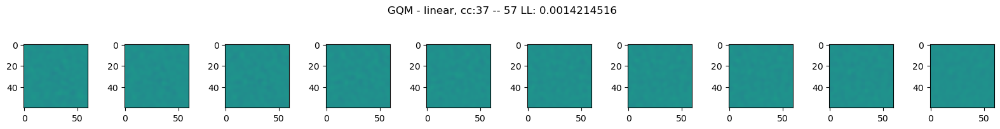

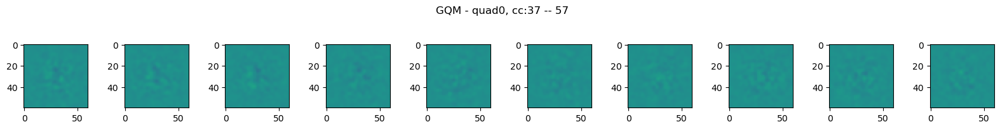

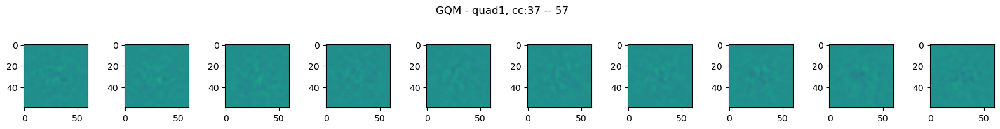

-------------


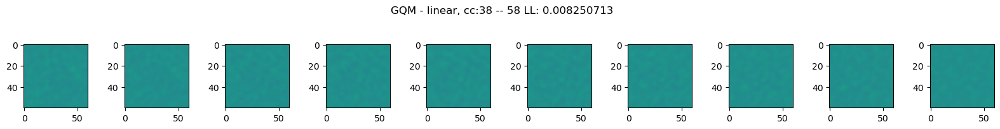

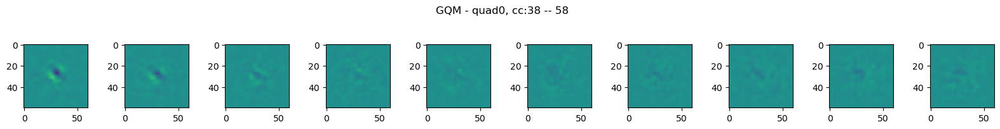

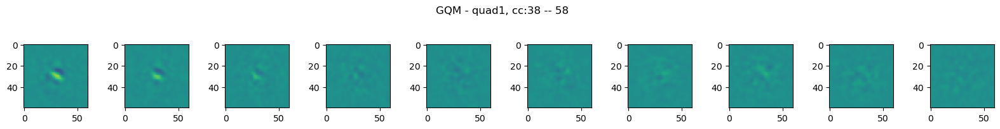

-------------


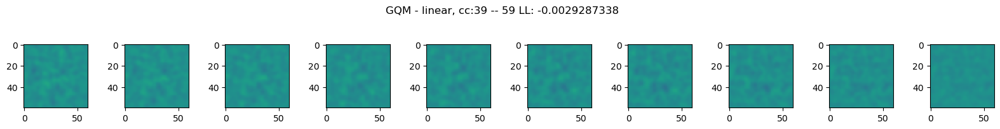

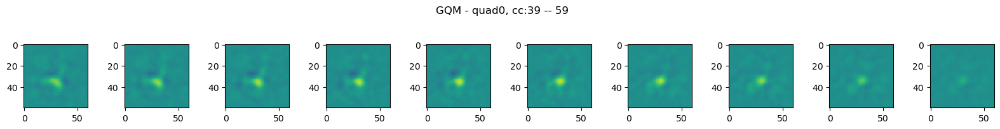

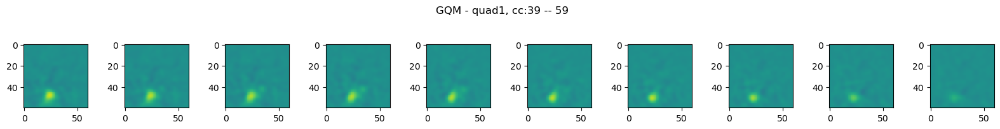

-------------


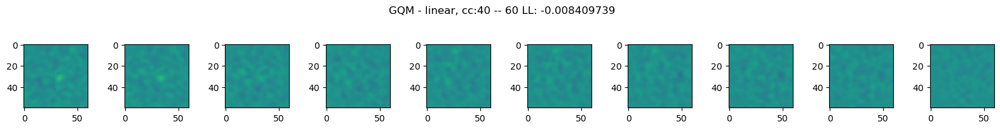

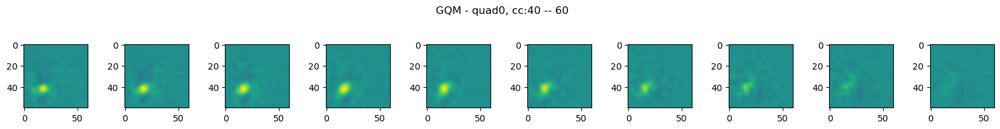

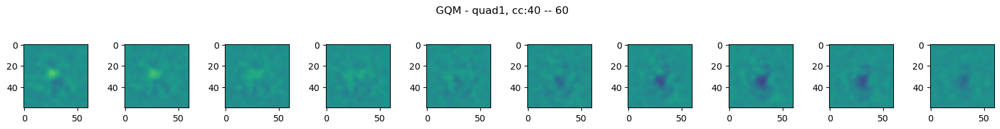

-------------


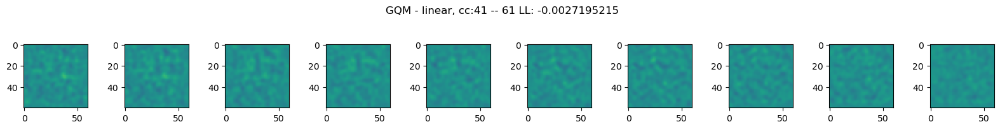

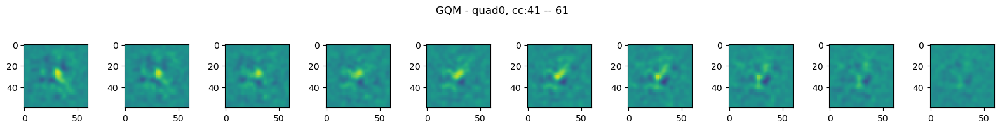

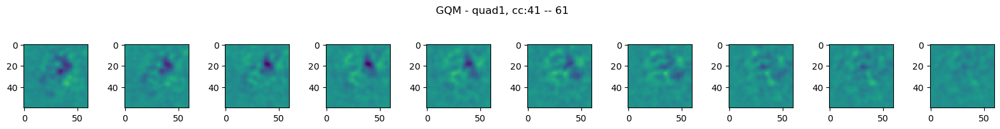

-------------


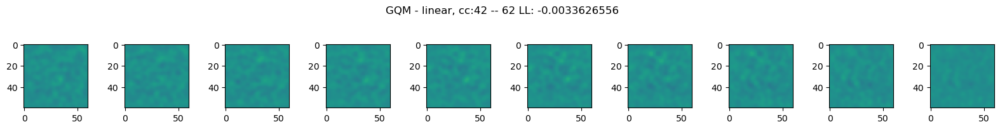

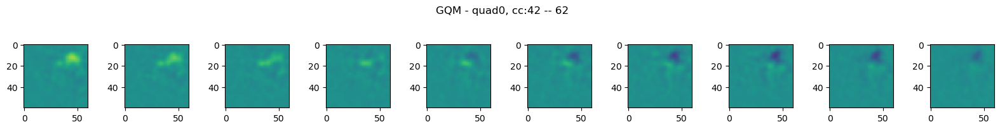

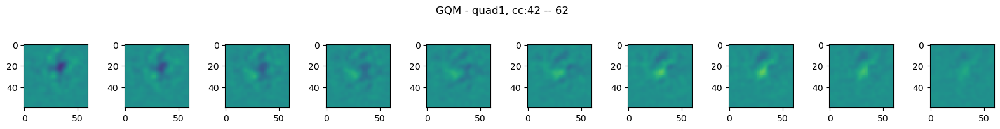

-------------


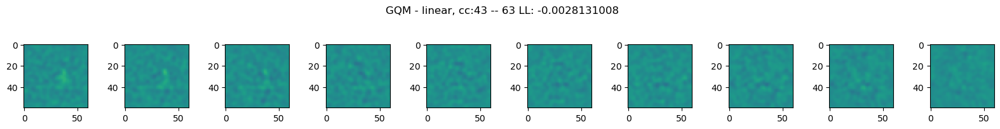

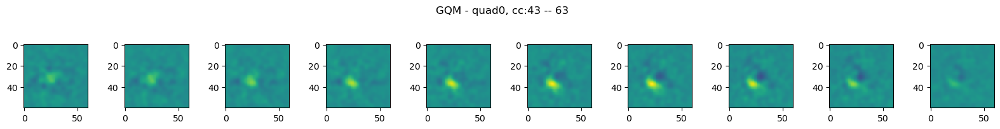

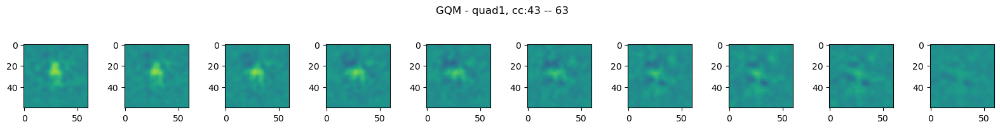

-------------


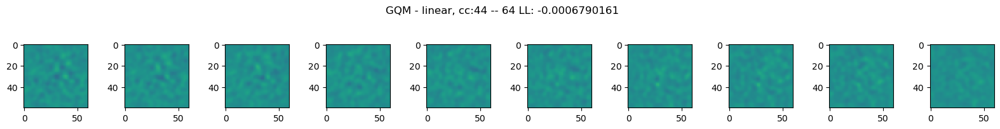

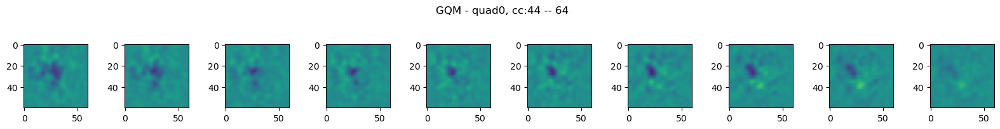

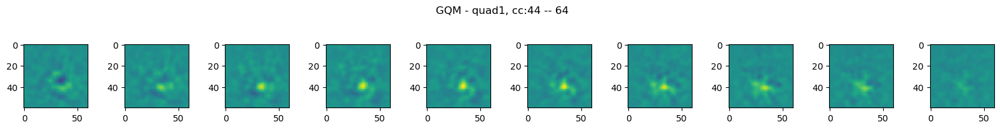

-------------


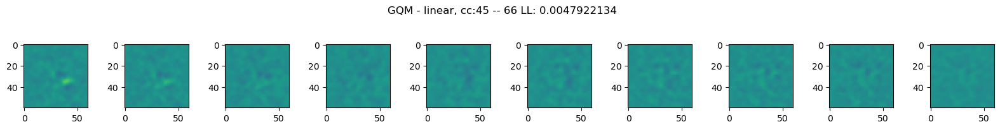

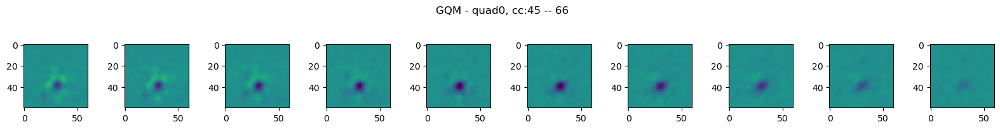

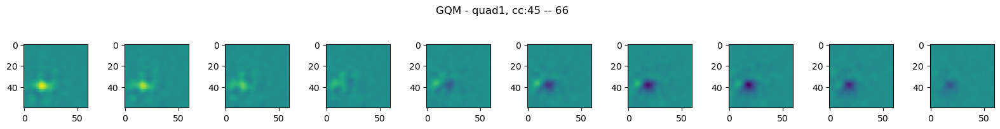

-------------


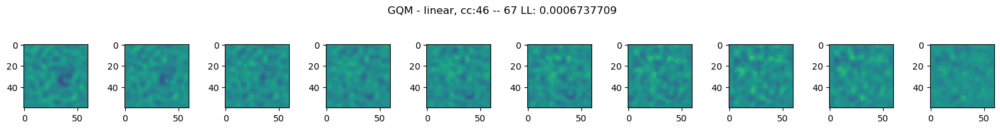

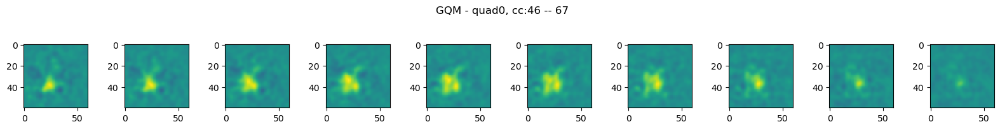

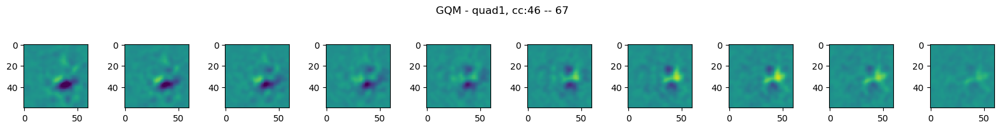

-------------


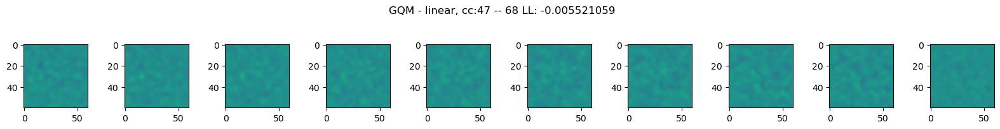

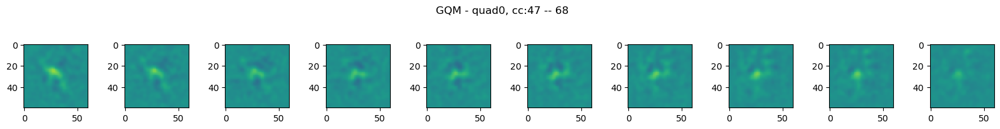

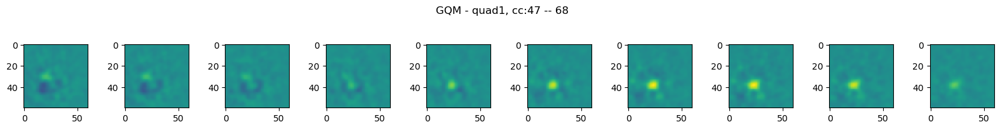

-------------


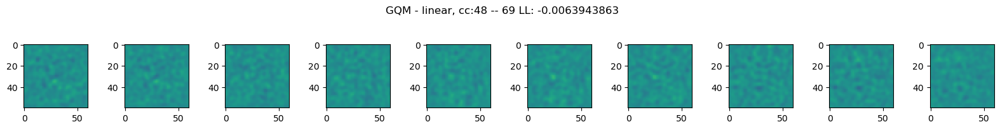

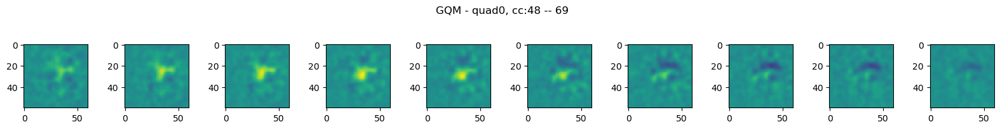

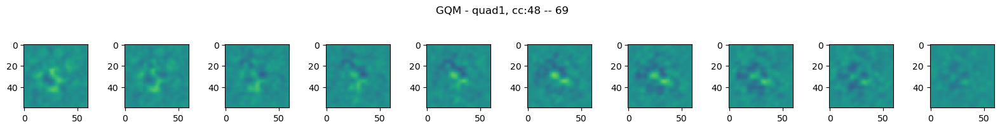

-------------


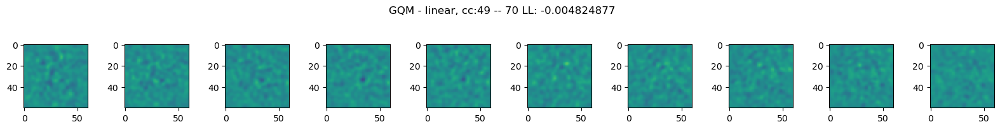

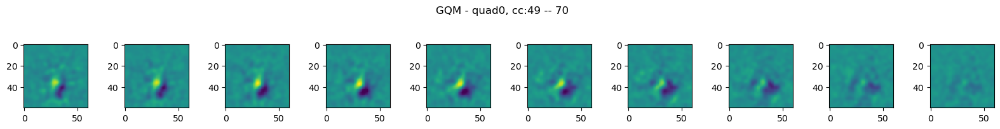

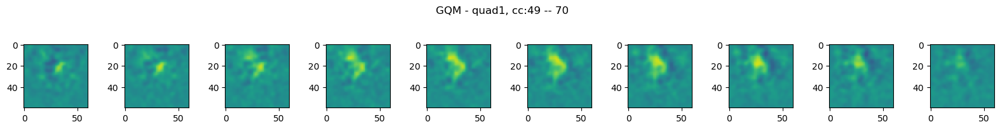

-------------


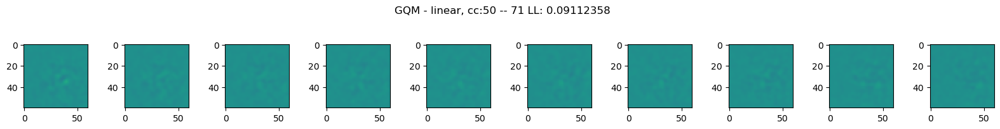

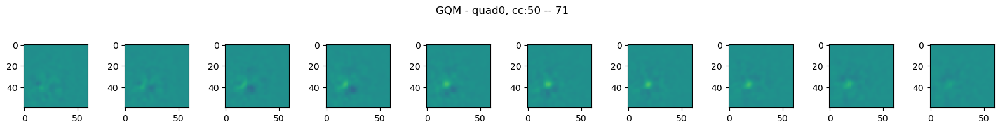

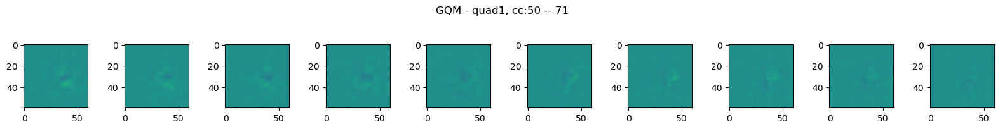

-------------


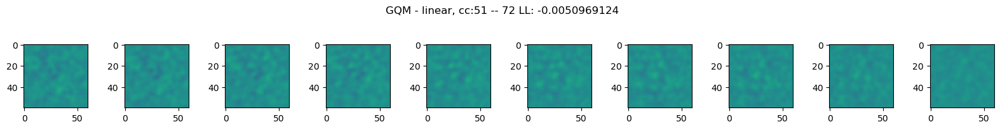

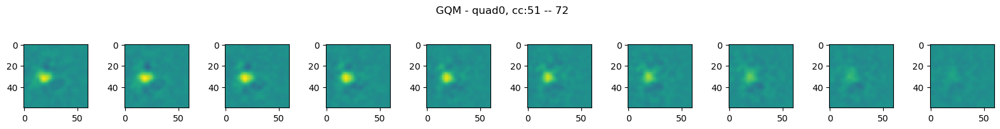

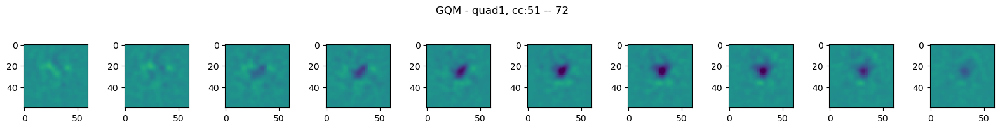

-------------


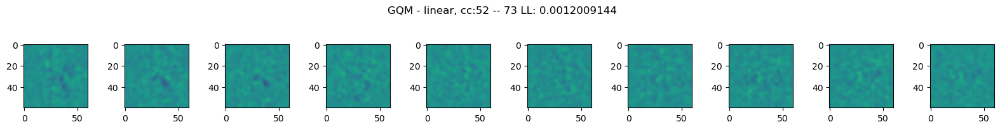

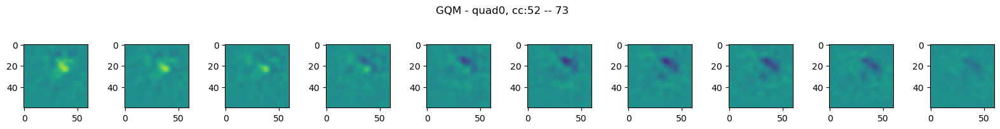

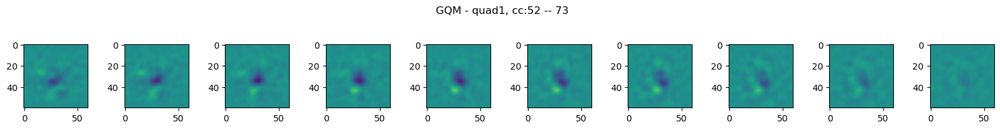

-------------


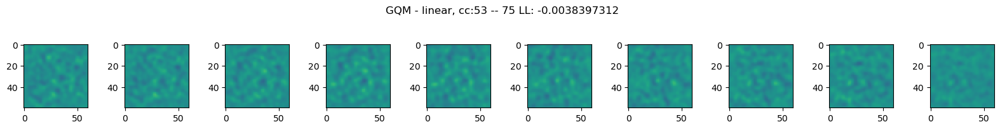

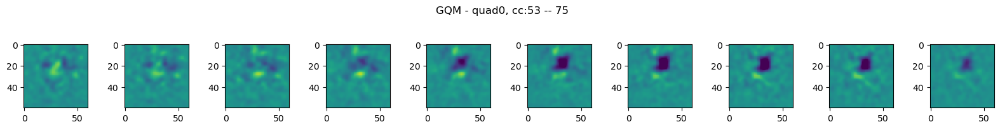

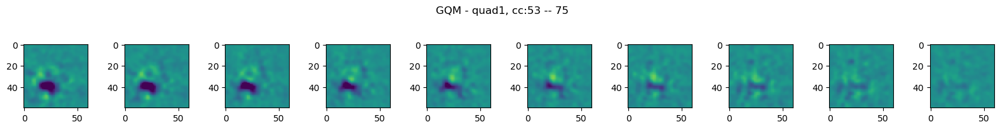

-------------


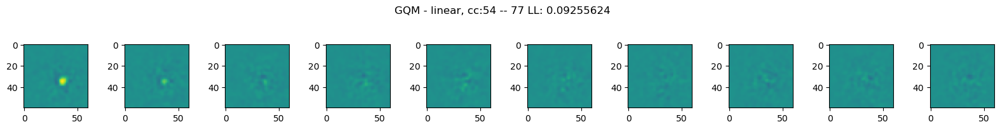

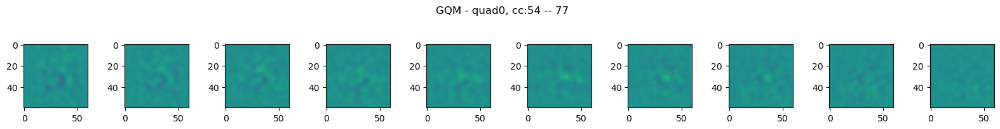

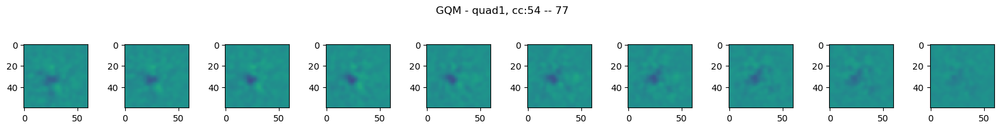

-------------


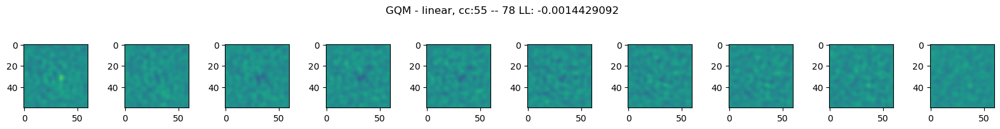

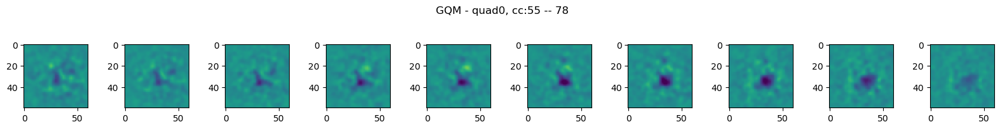

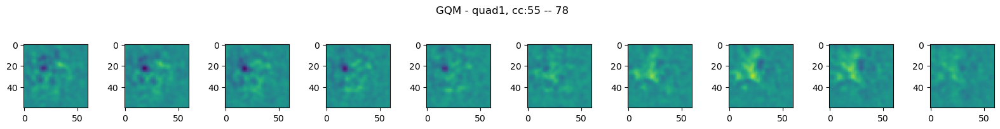

-------------


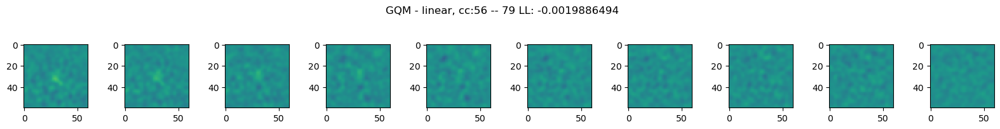

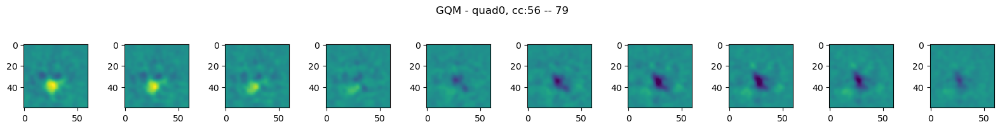

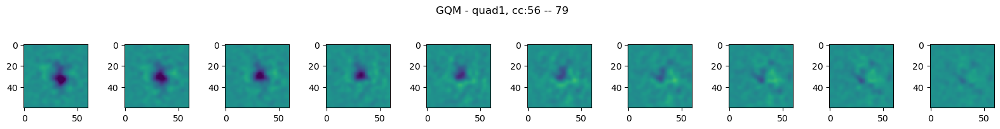

-------------


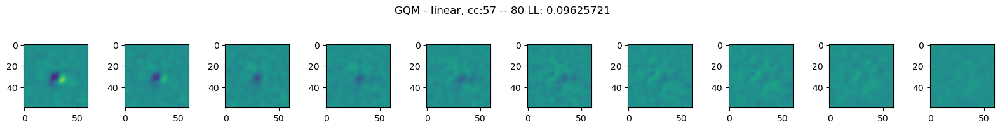

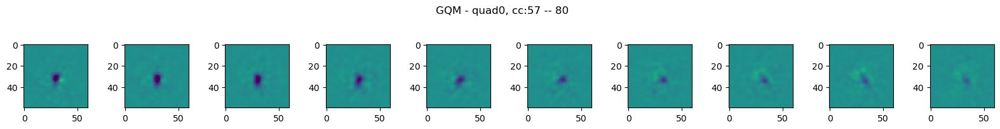

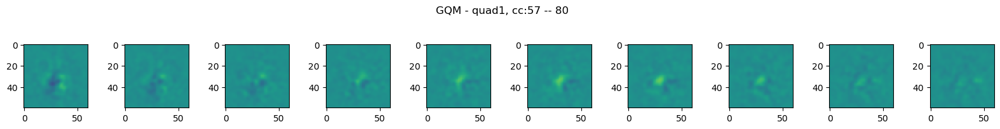

-------------


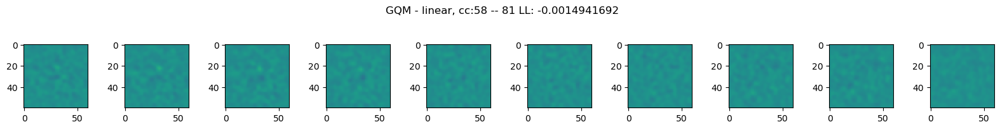

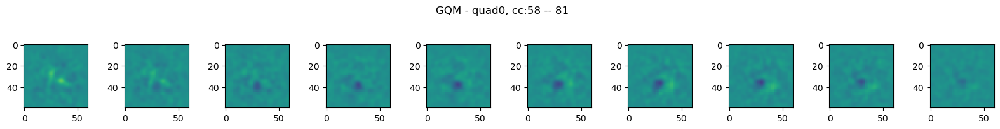

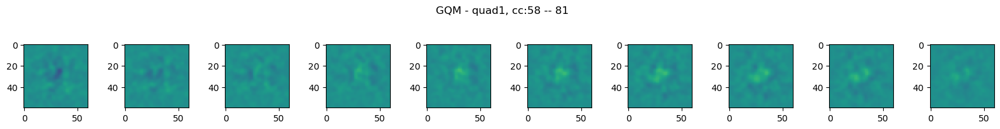

-------------


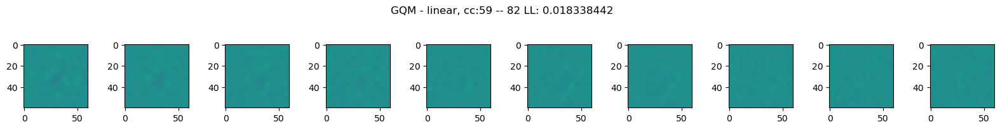

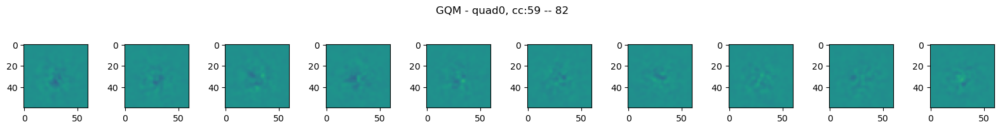

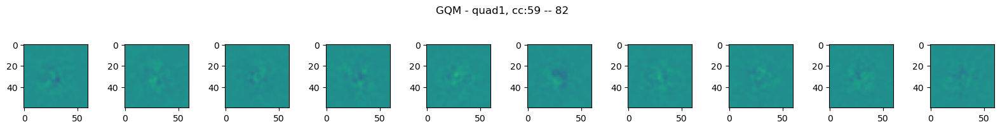

-------------


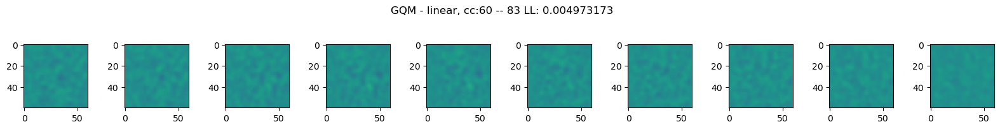

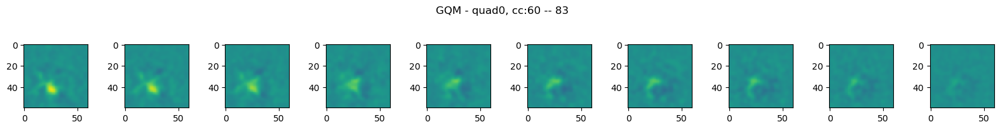

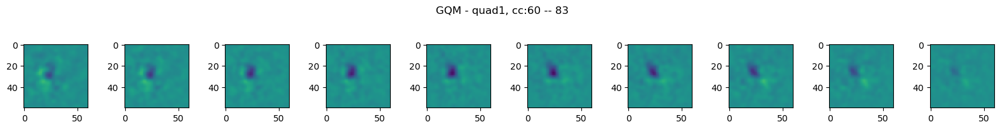

-------------


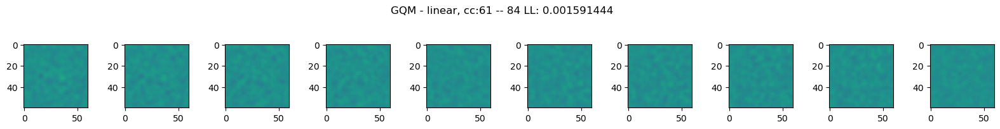

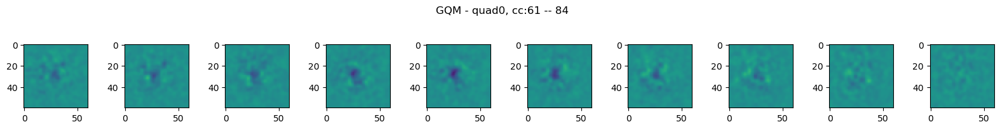

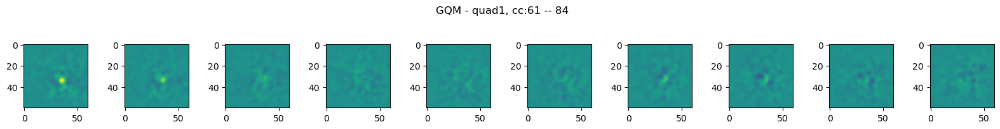

-------------


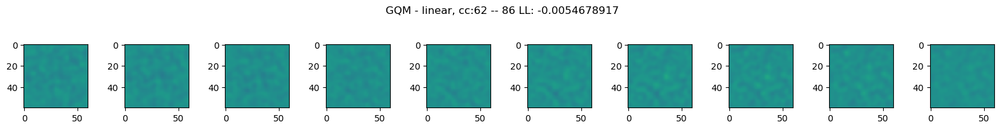

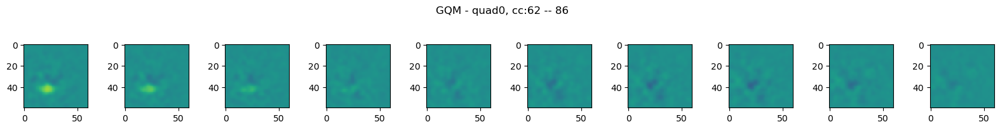

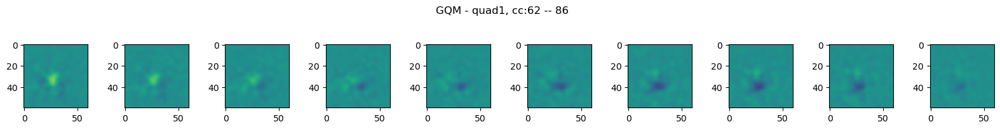

-------------


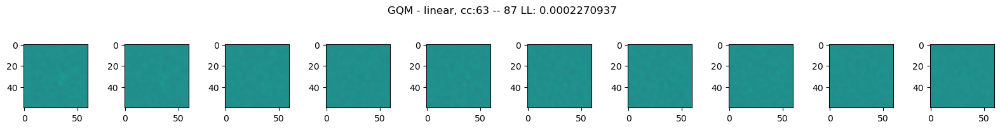

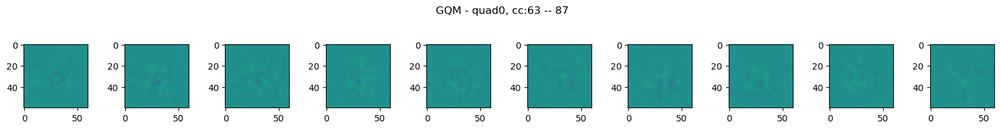

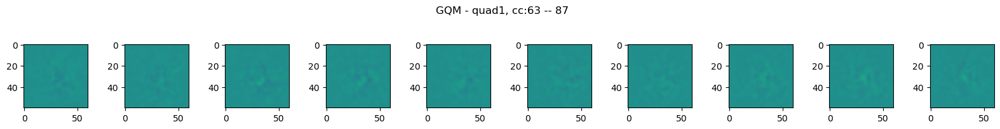

-------------


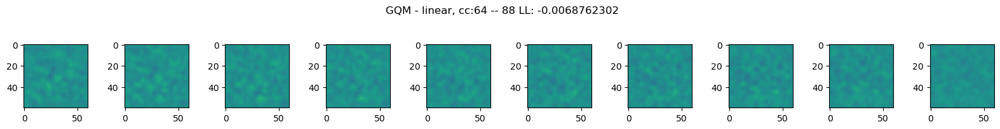

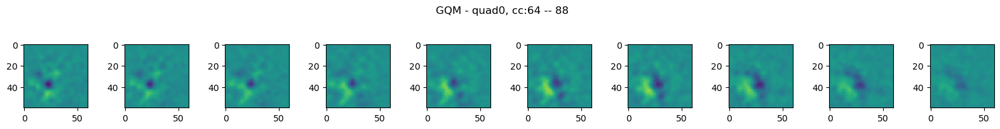

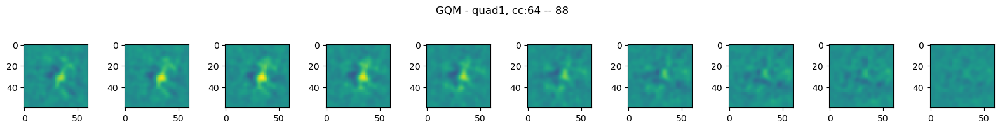

-------------


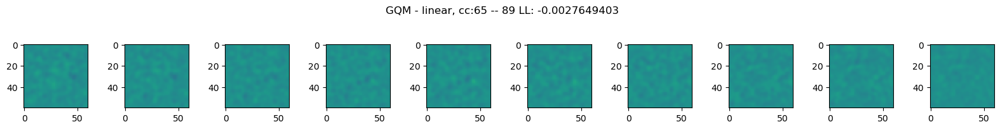

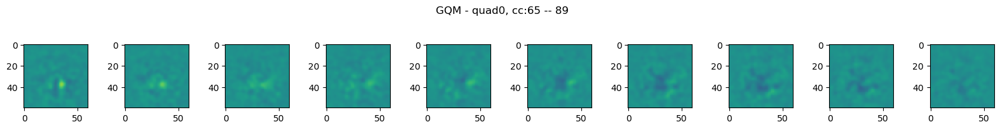

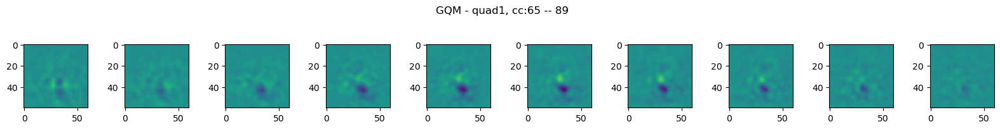

-------------


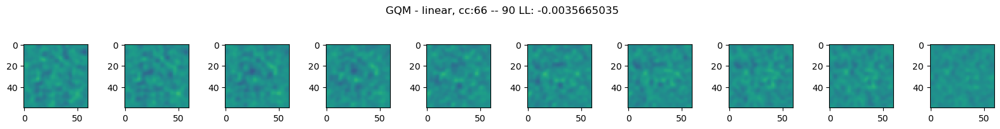

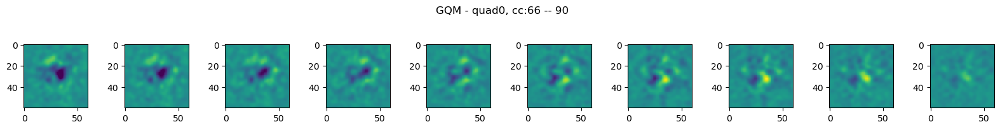

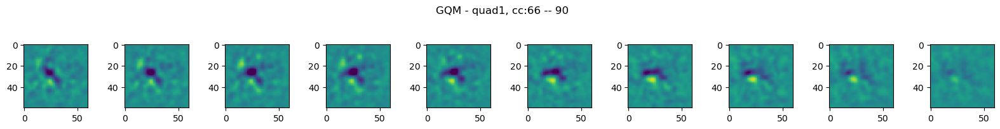

-------------


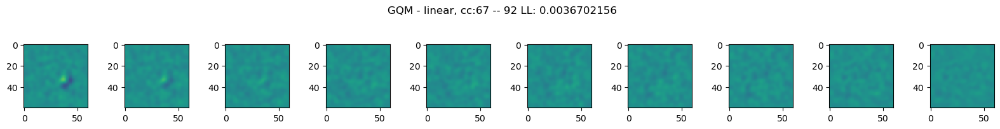

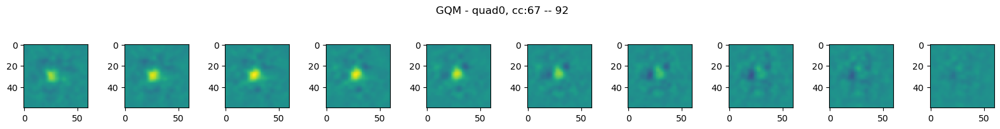

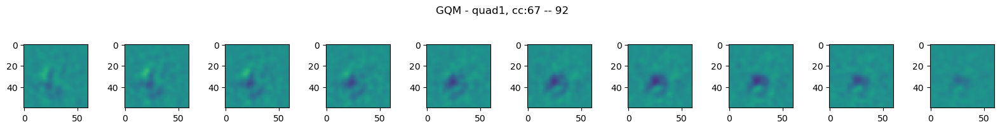

-------------


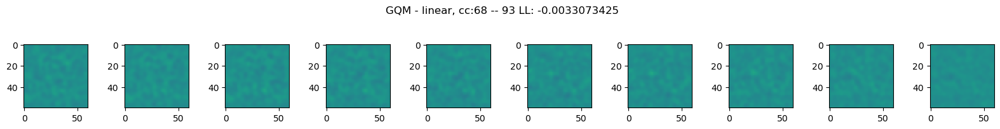

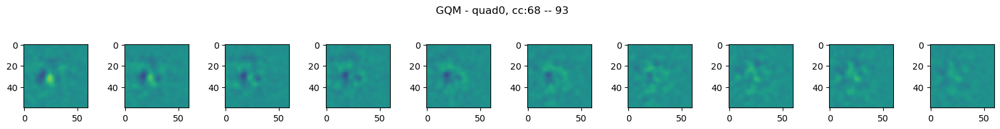

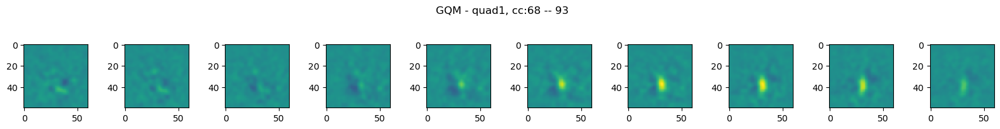

-------------


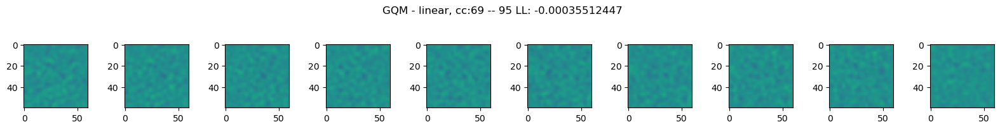

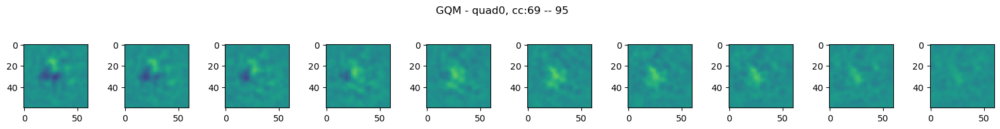

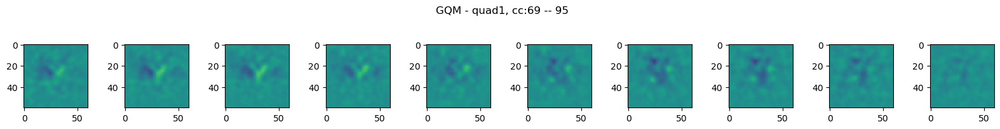

-------------


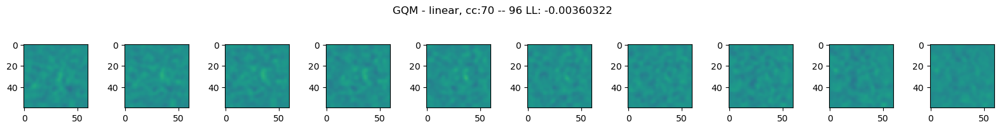

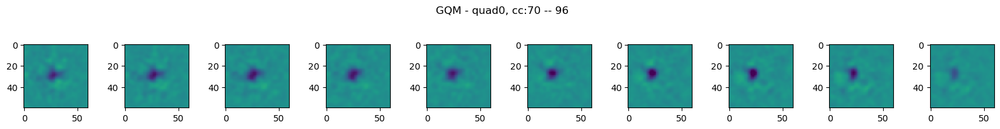

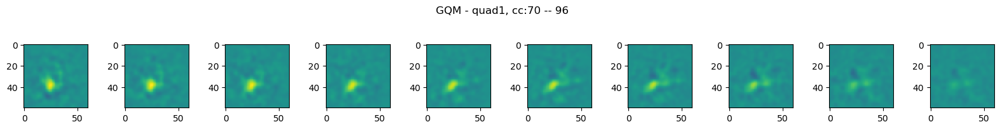

-------------


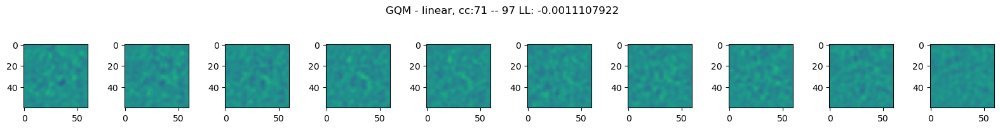

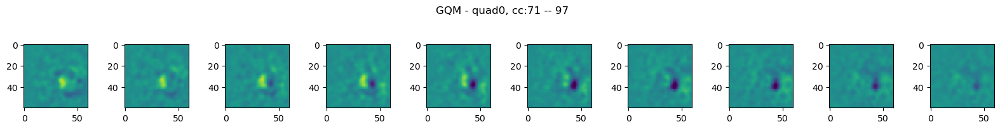

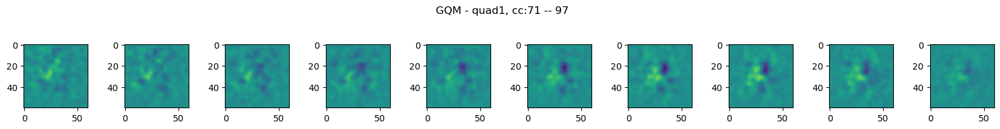

-------------


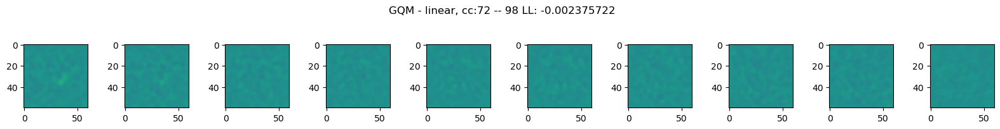

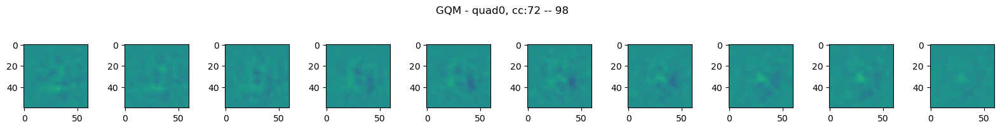

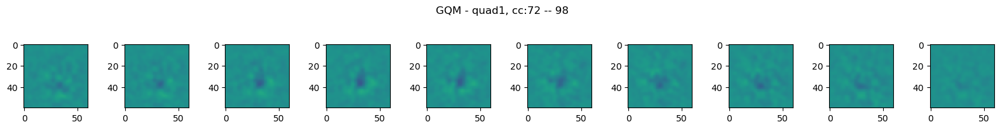

-------------


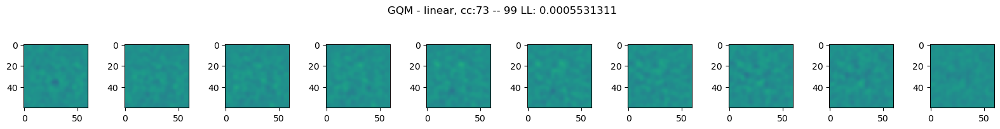

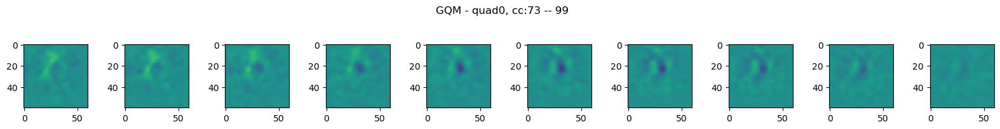

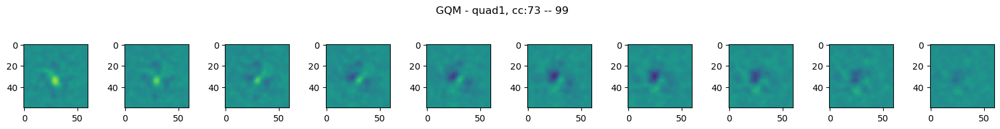

-------------


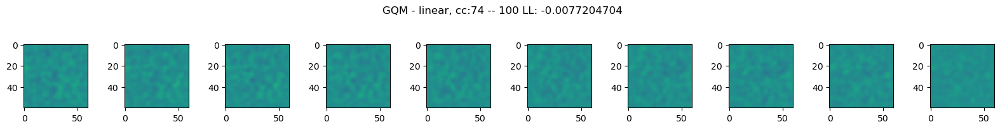

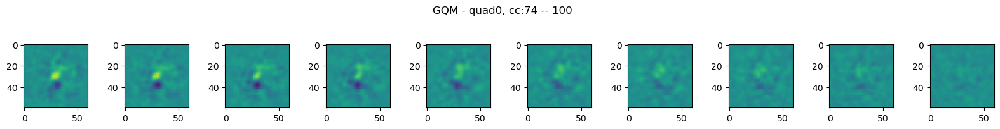

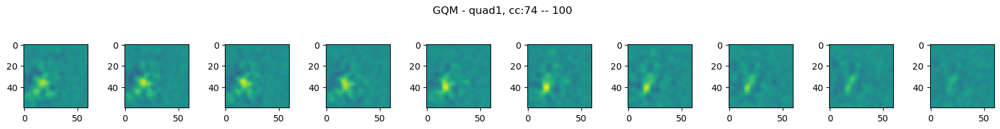

-------------


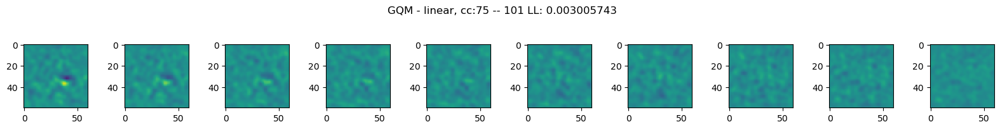

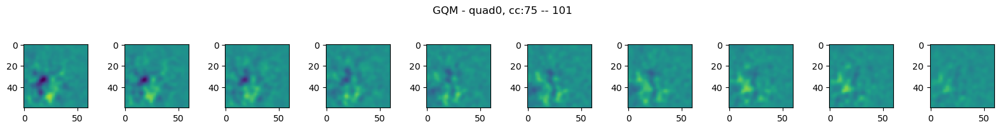

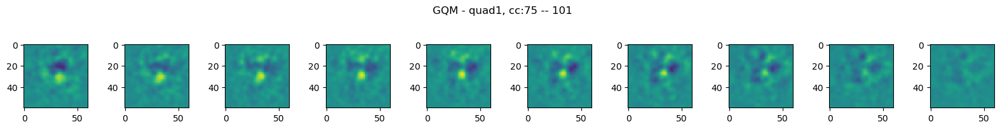

-------------


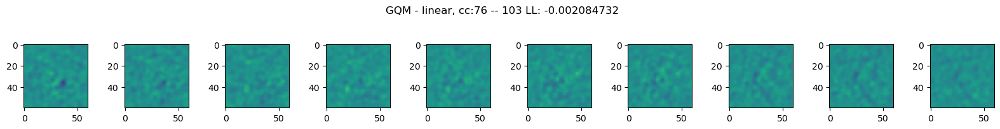

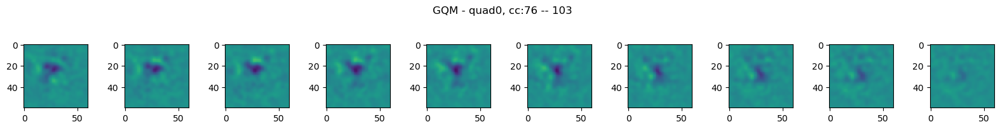

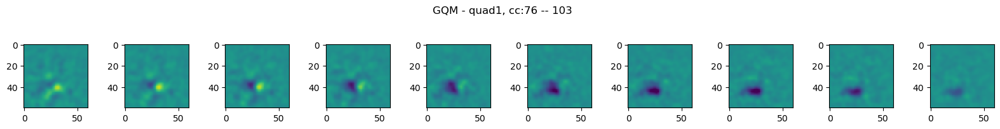

-------------


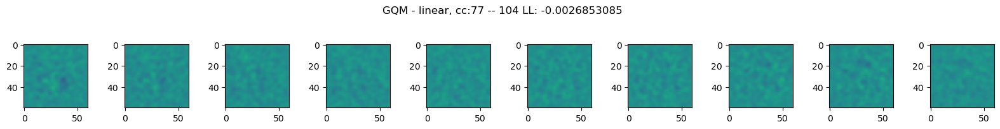

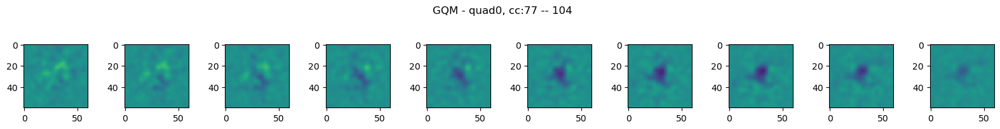

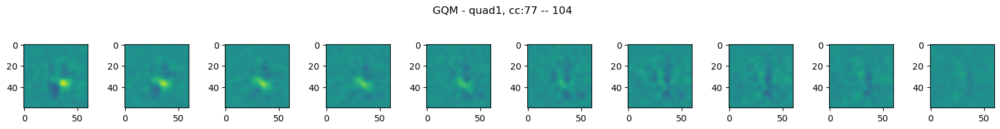

-------------


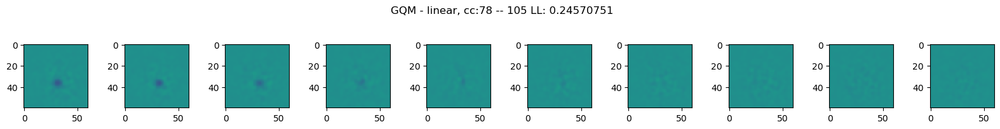

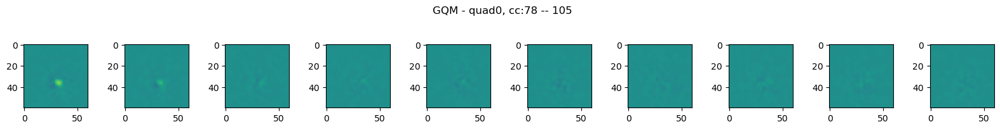

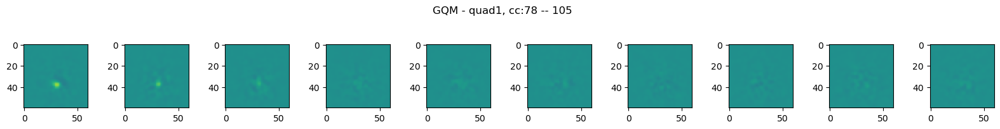

-------------


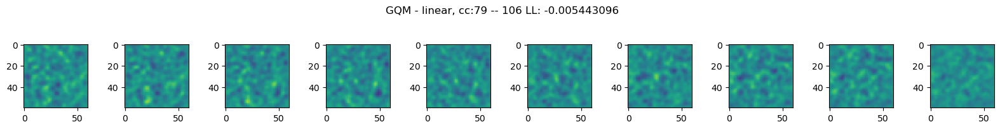

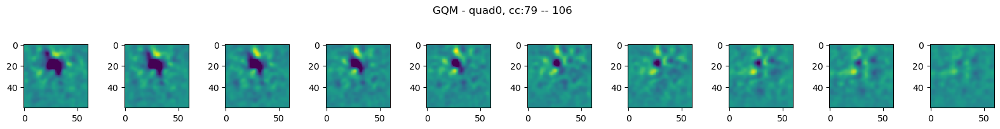

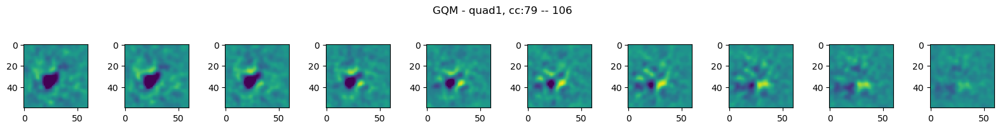

-------------


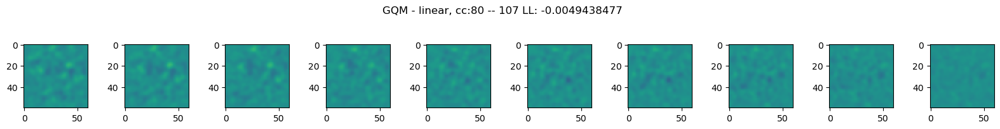

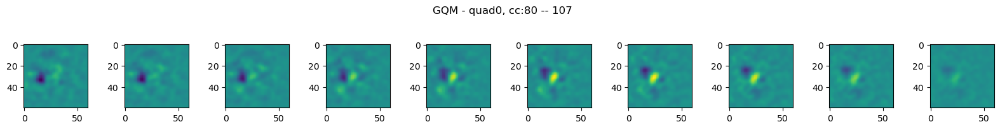

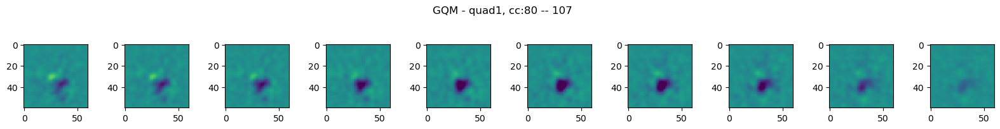

-------------


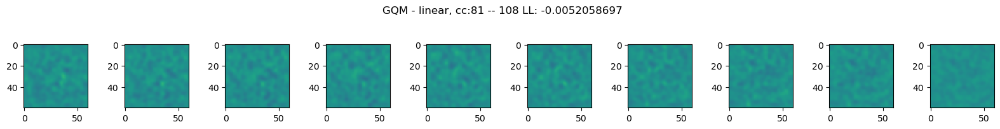

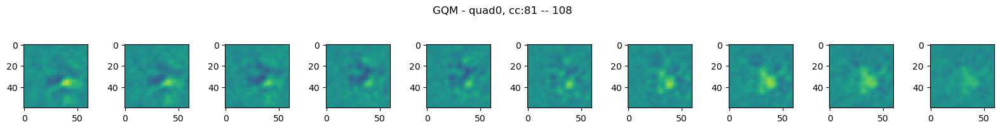

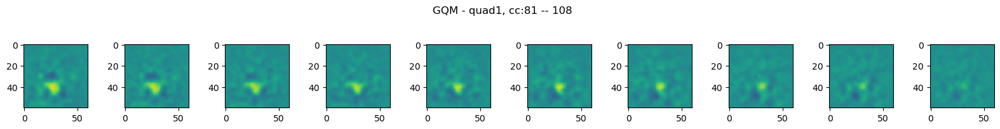

-------------


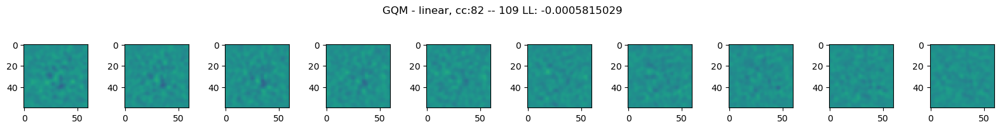

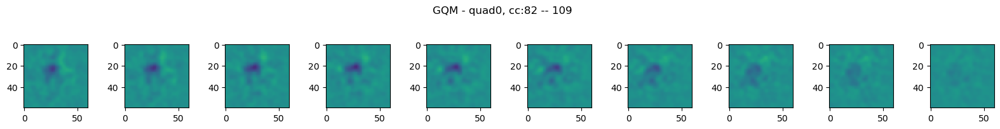

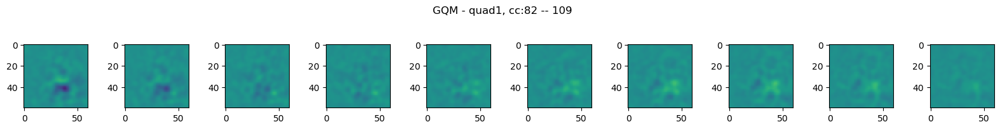

-------------


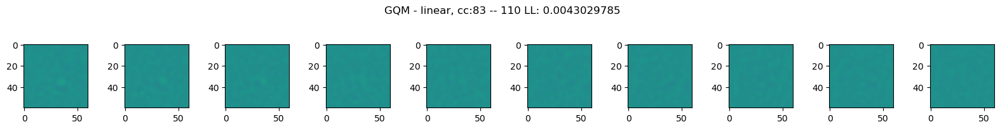

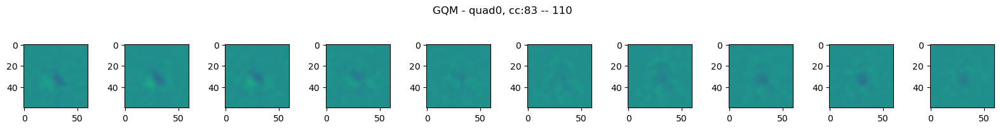

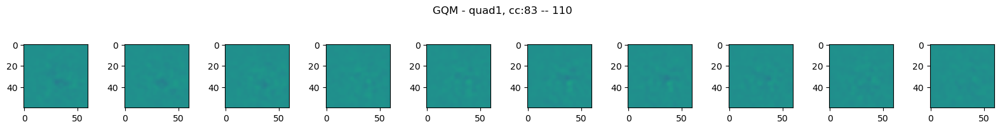

In [13]:
for i in range(gqms):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad
        
    print('-------------')
    ss(1,10)
    col = 1
    for lag in range(num_lags-1, -1, -1):
        plt.subplot(1,num_lags, col)
        imagesc(gqms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc(valET):' + str(i) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(num_lags-1, -1, -1):
        plt.subplot(1,num_lags, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc(valET):' + str(i))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(num_lags-1, -1, -1):
        plt.subplot(1,num_lags, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc(valET):' + str(i))
        col += 1
    plt.show()

## plot cross-sections
   of direction selective cells

(60, 60, 10) (60, 60, 10) (60, 60, 10)
-------------


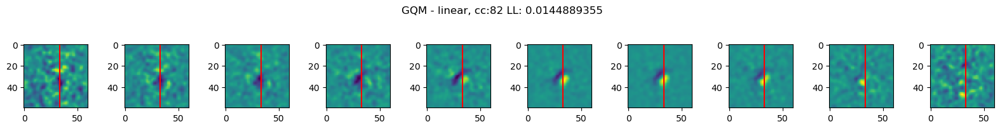

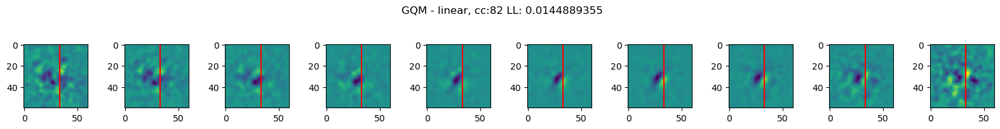

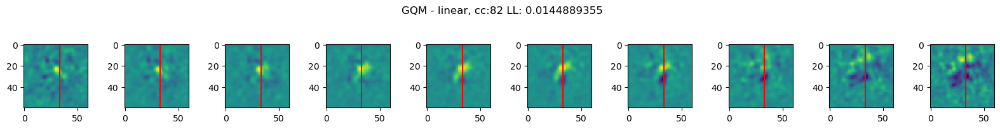

In [25]:
# start with cell 21 (looks like a direction selective cell)
linear = gqms[-1].ndn_model.networks[0].layers[0].get_weights()[:,:, :, 0]
quad0 = gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, :, 0]
quad1 = gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, :, 1]
print(linear.shape, quad0.shape, quad1.shape)

print('-------------')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0])
    # draw a vertical line at the center of the image
    plt.axvline(x=33, color='r')
    plt.suptitle('GQM - linear, cc:' + str(valET[interesting_cells[-1]]) + ' LL: ' + str(gqms[-1].LLs))
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0])
    plt.suptitle('GQM - quad0, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(gqms[-1].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1])
    plt.suptitle('GQM - quad1, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
plt.show()

Text(0, 0.5, 'time')

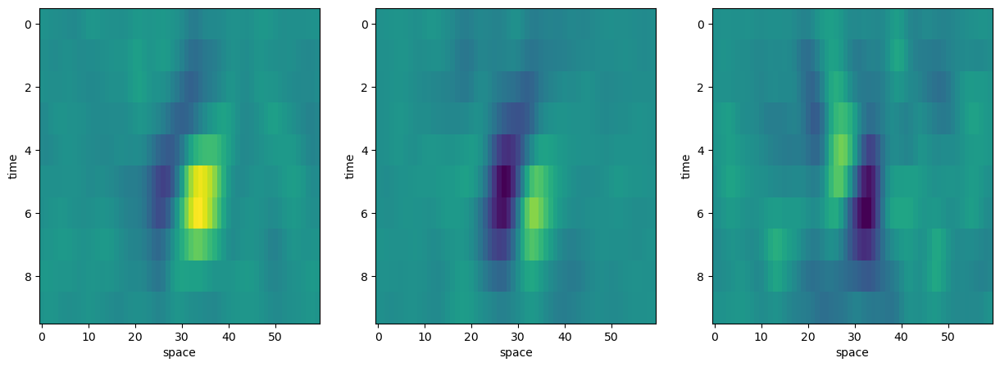

In [29]:
# take a vertical slice of each of the linear and quadratic receptive fields to plot in a single image
x = 33
plt.figure(figsize=(15,5))
linear_slice = linear[:, x, :]
quad0_slice = quad0[:, x, :]
quad1_slice = quad1[:, x, :]
plt.subplot(1,3,1)
imagesc(linear_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,2)
imagesc(quad0_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,3)
imagesc(quad1_slice)
plt.xlabel('space')
plt.ylabel('time')

# CNNs

## load models

In [49]:
cnns = []
for i in range(4,5):
    with open('models/cnns_04/cnn_'+str(i)+'.pkl', 'rb') as f:
        cnns.append(pickle.load(f))

with open('models/cnns_04/study.pkl', 'rb') as f:
    study = pickle.load(f)

In [51]:
# plot LLs
fig = plt.figure(figsize=(10, 5))
plt.plot([np.mean(cnn.LLs) for cnn in cnns])
# put an asterisk on the best model
plt.plot(study.best_trial.number-3, np.mean(cnns[study.best_trial.number-3].LLs), '*')
plt.show()

print(study.best_trial.number-3)

best_cnn = cnns[study.best_trial.number-3].ndn_model

ValueError: No trials are completed yet.

In [68]:
best_cnn = cnns[0].ndn_model
best_LLs = cnns[0].LLs

0.027291889848380255


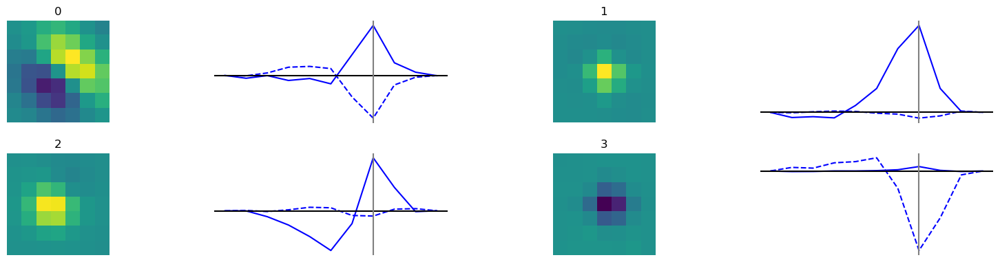

In [59]:
for cnn in cnns:
    print(np.mean(cnn.LLs))
    cnn.ndn_model.plot_filters()
    plt.show()

## best parameters

In [56]:
trials = study.trials

# sort trials by values[0]
fig = plt.figure(figsize=(25, 10))
trials = sorted(trials, key=lambda x: x.values[0] if x.values is not None else -100)

<Figure size 2500x1000 with 0 Axes>

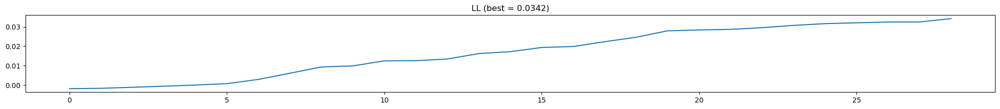

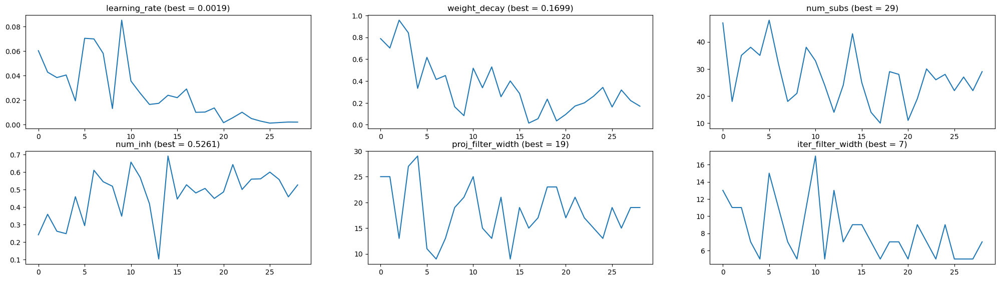

In [64]:
fig = plt.figure(figsize=(25, 2))
plt.plot([trial.values[0] for trial in trials if trial.values is not None])
plt.title('LL (best = ' + '%.4f' % trials[-1].values[0] + ')')
plt.show()

fig = plt.figure(figsize=(25, 10))
grid = matplotlib.gridspec.GridSpec(3, 3, hspace=0.2, wspace=0.2)
for i, k in enumerate(trials[-1].params.keys()):
    row,col = np.unravel_index(i, (3,3))
    plt.subplot(grid[row,col])
    plt.plot([trial.params[k] for trial in trials if trial.values is not None])
    # if number is a float
    if isinstance(trials[-1].params[k], float):
        plt.title(k + ' (best = ' + '%.4f' % trials[-1].params[k] + ')')
    else:
        plt.title(k + ' (best = ' + str(trials[-1].params[k]) + ')')

## predict from the CNN

In [60]:
pred = best_cnn.generate_predictions(data, batch_size=10)

Eval models: 100%|██████████████████████████████████████████████████████████████████████████████████████████| 70/70 [05:50<00:00,  5.00s/it]


In [99]:
len(data)

167520

## generate_predictions()

In [115]:
import tqdm
num_cells = 174 # data.NC
block_size = 240
batch_size = 10
total = 100 # len(data)
pred = torch.zeros((total*block_size, num_cells))
with torch.no_grad():
    for i in tqdm.tqdm(range(0, total, batch_size)):
        pred[i*block_size:(i+batch_size)*block_size] = best_cnn(data[i:i+batch_size])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:52<00:00,  5.30s/it]


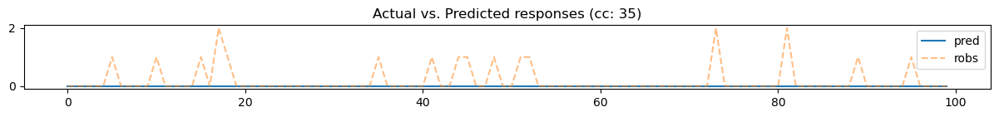

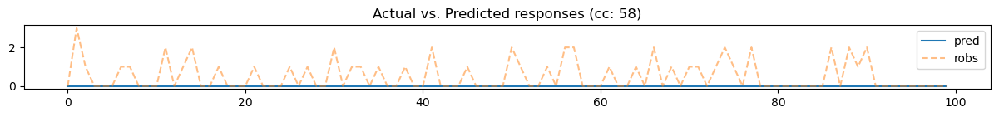

In [113]:
# plot preds vs. robs for each cell
for cc in interesting_cells:
    plt.figure(figsize=(15,1))
    plt.plot(pred[10000:10100, cc], label='pred')
    plt.plot(data.robs[10000:10100, valET[cc]], label='robs', linestyle='--', alpha=0.5)
    plt.title('Actual vs. Predicted responses (cc: ' + str(valET[cc]) + ')')
    plt.legend()
    plt.show()

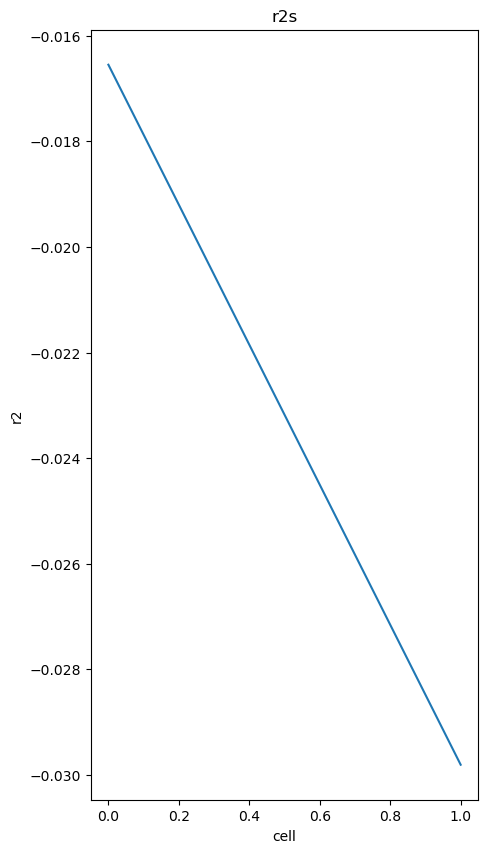

In [67]:
def r_squared(pred, robs):
    return 1 - torch.sum((pred - robs)**2) / torch.sum((robs -torch.mean(robs))**2)

# calculate r2 for each cell
r2s = []
for cc in interesting_cells:
    r2 = r_squared(pred[:, cc], data.robs[:, valET[cc]])
    r2s.append(r2)
    
# plot r2s
plt.figure(figsize=(5,10))
plt.plot(r2s)
plt.title('r2s')
plt.xlabel('cell')
plt.ylabel('r2')
plt.show()

In [108]:
pred.shape, data.robs.shape, data.stim[:-lag, :].shape

((24000, 174), torch.Size([167520, 239]), torch.Size([167519, 3600]))

In [46]:
# set the robs in the data to the predicted robs
#data.robs = pred

## fit STAs from pred

In [116]:
stas = []
for lag in range(1,8):
    Reff = torch.mul(pred, data.dfs[:pred.shape[0], valET])
    #Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
    nspks = torch.sum(Reff, axis=0)
    stas.append(((data.stim[:pred.shape[0]-lag, :].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).detach().numpy())

STAs


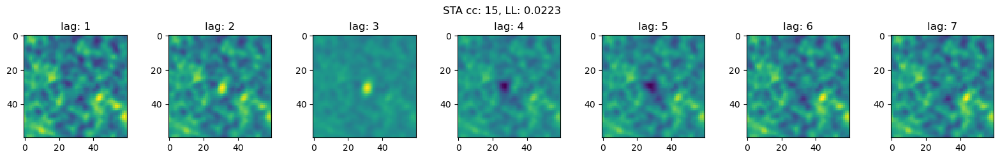

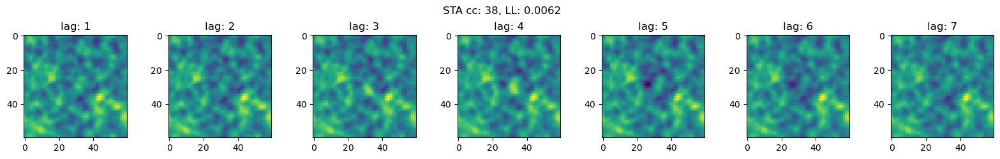

In [117]:
print("STAs")
for cc in interesting_cells:
    ss(1,7)
    col = 1
    for lag in range(len(stas)):
        plt.subplot(1,7, col)
        imagesc(stas[lag][:,:, cc])
        plt.title('lag: ' + str(lag+1))
        col += 1
    # adjust the plot down
    plt.subplots_adjust(top=0.8)
    plt.suptitle('STA cc: ' + str(cc) + ', LL: %.4f' % + best_LLs[cc])
plt.show()

TypeError: list indices must be integers or slices, not tuple

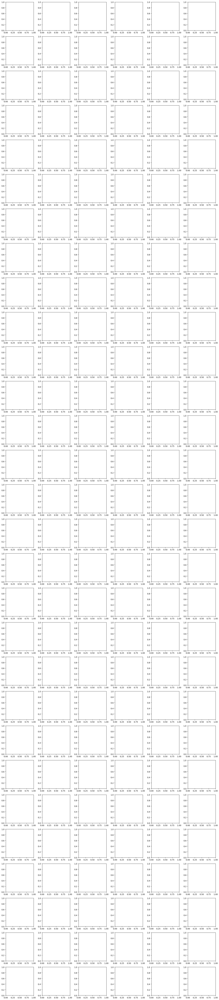

In [81]:
# plot STAs
ss(29,6)
for cc in range(NCv):
    plt.subplot(29,6, cc+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

## fit Drift from pred

In [51]:
drifts = []
for i, cc in enumerate(interesting_cells):
    drift = fit_drift(i, cc, folder='glms_03_pred')[0]
    drifts.append(drift)

loading model 18
loading model 24
loading model 38
loading model 46
loading model 54
loading model 57


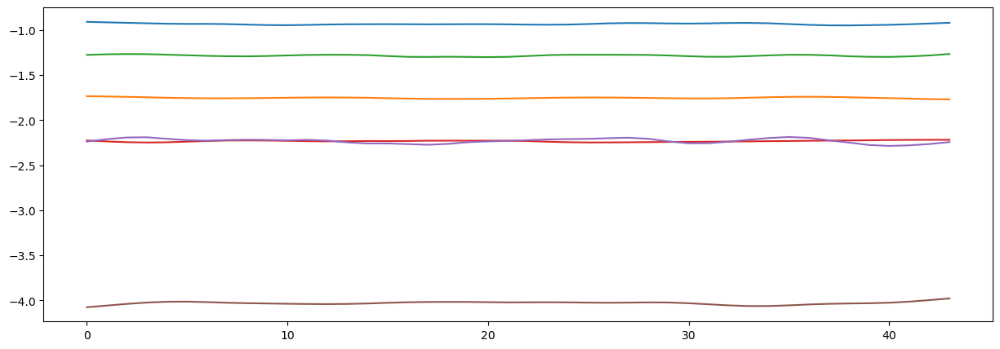

In [58]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    plt.plot(drift.ndn_model.networks[0].layers[0].get_weights())

## fit GLM from pred

In [59]:
glms = []
for i, cc in enumerate(interesting_cells):
    glm = fit_glm(i, cc, folder='glms_03_pred')[0]
    glms.append(glm)

loading model 18
loading model 24
loading model 38
loading model 46
loading model 54
loading model 57


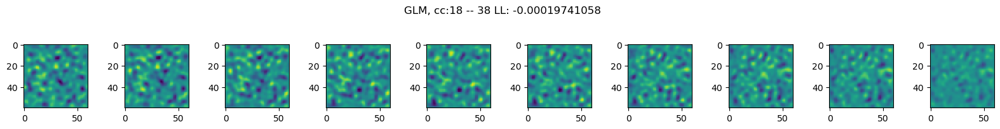

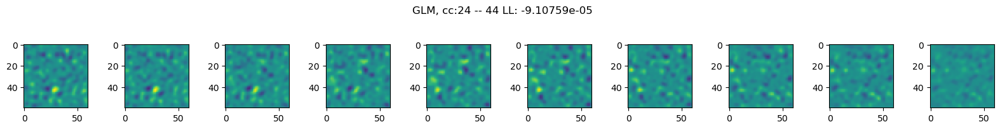

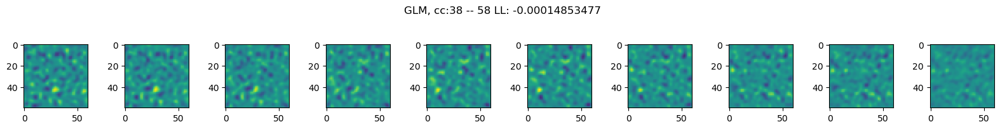

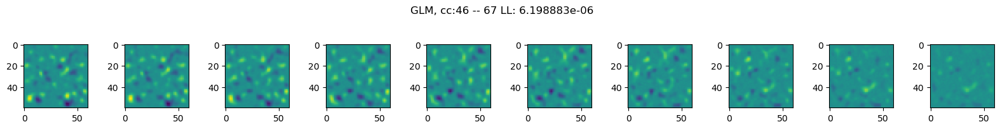

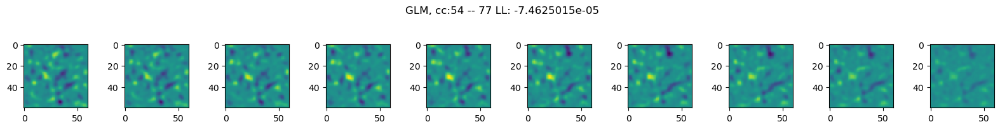

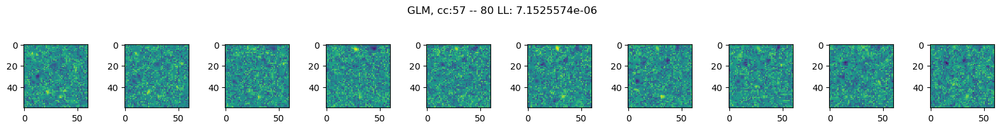

In [60]:
for i, cc in enumerate(interesting_cells):
    max_weights = np.max(glms[i].ndn_model.networks[0].layers[0].get_weights())
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(glms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GLM, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(glms[i].LLs))
        col += 1
    plt.show()

## fit GQM from pred

In [ ]:
gqms = []
gqm_studies = []
for i, cc in enumerate(range(0, 84)):
    gqm, study = fit_gqm(i, cc, 'glms_03_pred')
    gqms.append(gqm)
    gqm_studies.append(study)

-------------


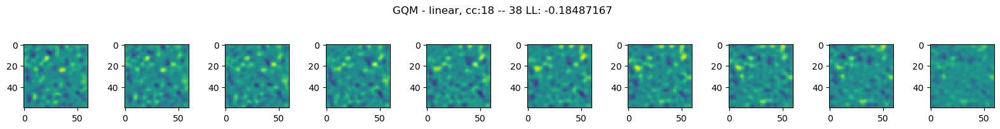

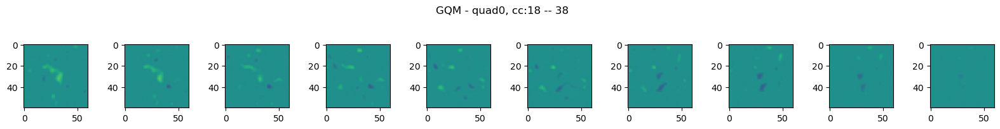

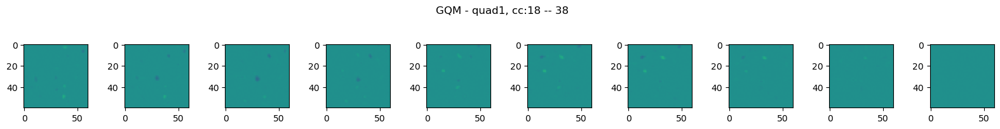

-------------


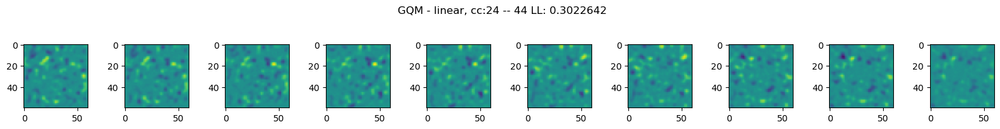

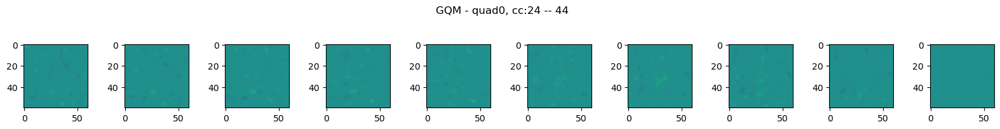

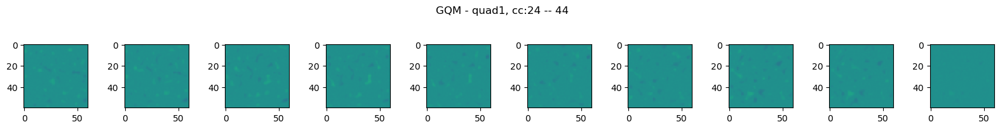

-------------


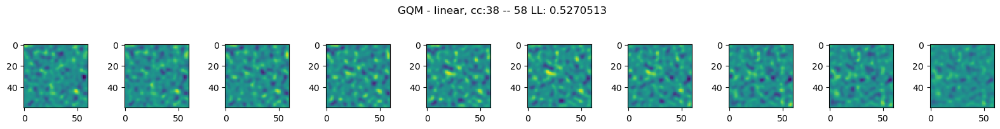

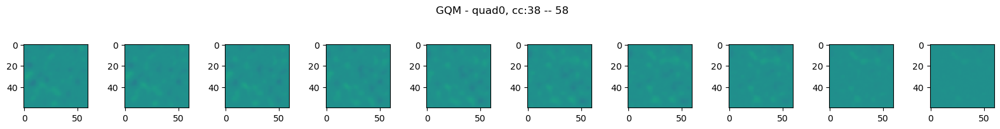

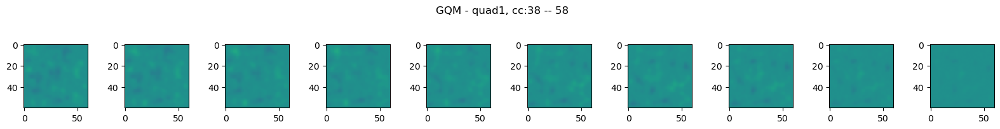

-------------


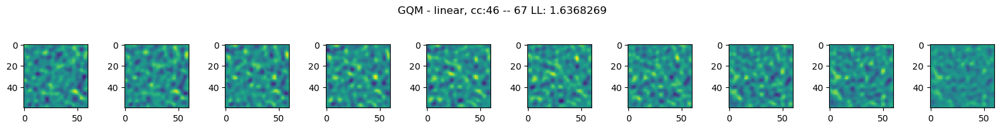

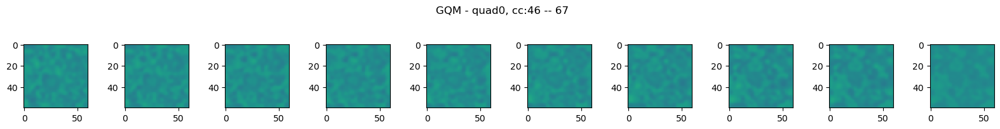

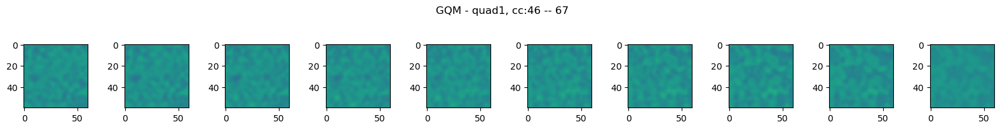

-------------


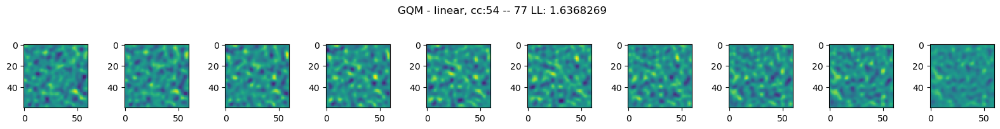

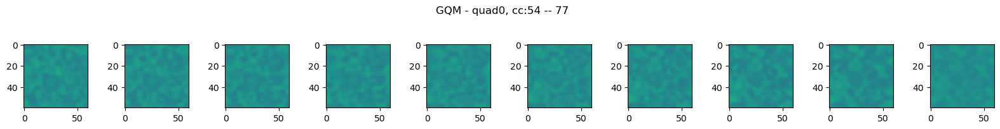

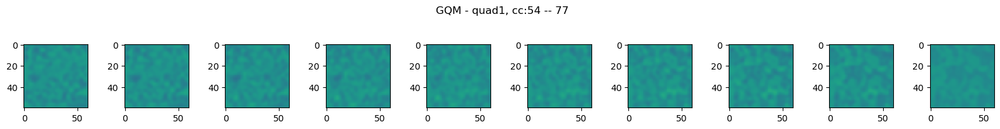

-------------


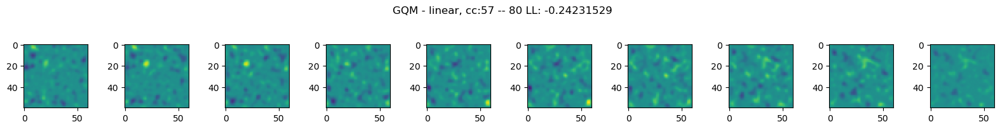

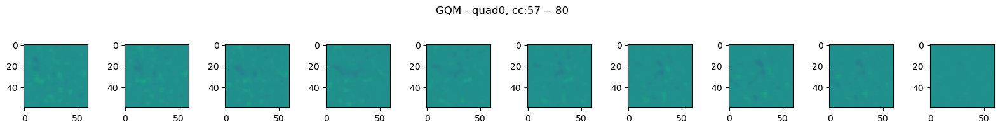

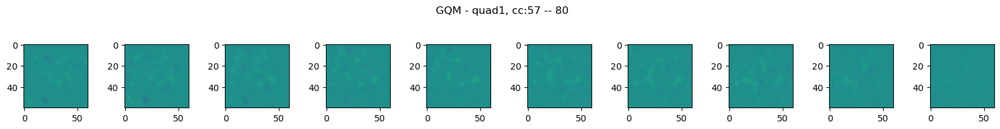

In [71]:
# plot filters
for i, cc in enumerate(interesting_cells):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    print('-------------')
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    ss(1,10)
    col = 1
    for lag in range(9, -1, -1):
        plt.subplot(1,10, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    plt.show()